# large dataset STEM on nanoparticles

## Imports and settings


In [ ]:
# !pip install m3-learning
# 

: 

In [1]:
import sys
import glob
import os
sys.path.append('./../')
sys.path.append('./../../src/m3_learning')
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
import hyperspy.api as hs
import torch
import h5py
# import nn
from nn.random import random_seed
from viz.style import set_style
from viz.printing import printer
from viz.Movies import make_movie
from nn.STEM_AE.Dataset import STEM_Dataset
from util.file_IO import download_and_unzip
from ipywidgets import interact

from nn.STEM_AE.Viz import Viz
from nn.STEM_AE.STEM_AE import ConvAutoencoder
# Specify the filename and the path to save the file
data_path = './../../Northwestern_link/Northwestern/'
fig_path = './../../Northwestern_Figures/'

# builds the printer object
printing = printer(basepath=fig_path,fileformats=['png'])

# Set the style of the plots
set_style("printing")

# Set the random seed for reproducibility
random_seed(seed=42)

%matplotlib inline


printing set for seaborn
Pytorch seed was set to 42
Numpy seed was set to 42


In [2]:
torch.cuda.is_available()

True

## Domains 

### Loads the Dataset

save in format (save_folder)/particles/instrument/composition/SI data (#)/Diffraction SI.dm4 for correct data processing

In [3]:
# # take about 21 minutes to write entire h5 file in numpy, or about 10s per dataset
dset = STEM_Dataset(data_path,
                    f'{data_path}/*/*/*/SI data (*)/Diffraction SI.dm4',
                    overwrite=False)

fetching metadata...


  0%|          | 0/126 [00:00<?, ?it/s]

 97%|█████████▋| 122/126 [00:03<00:00, 36.15it/s]

bad ./../../Northwestern_link/Northwestern/aucu_agcu/2021_06_23_stela_80kV/AuCu/SI data (29)/Diffraction SI.dm4


 99%|█████████▉| 125/126 [00:03<00:00, 33.35it/s]


124 valid samples
fitting scaler...
finding brightfield indices


100%|██████████| 124/124 [00:27<00:00,  4.57it/s]

done


### Visualizer object

- use h5netcdf to open h5 files as xarray
- use hvplot to plot xarray

In [7]:
# instantiates the visualization class
viz = Viz(printer=printing, labelfigs_=True)
viz.scalebar_ = {"width": 250, "scale length": 100, "units": "nm", "channel": -1}

### Visualizes the Raw Data


BokehModel(combine_events=True, render_bundle={'docs_json': {'92ce5e03-7d63-46e3-b108-15905650f042': {'version…

<Figure size 640x480 with 0 Axes>

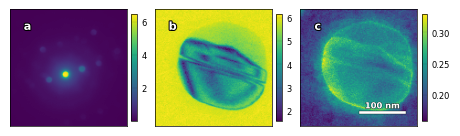

In [15]:
import panel as pn
pn.extension()

# Define a function to visualize raw and virtual STEM data
def visualize_raw_and_virtual(ind, bright_field, dark_field, scalebar):
    # Call the STEM_raw_and_virtual method from Viz
    viz.STEM_raw_and_virtual(dset, ind, bright_field, dark_field, scalebar, using_panel=True)
    # You may want to return the generated figures or images here
    
# Create Panel widgets for user interaction
ind_slider = pn.widgets.IntSlider(name='Index', start=0, end=len(dset.meta['path_list']) - 1)
bright_field_checkbox = pn.widgets.Checkbox(name='Bright Field', value=True)
dark_field_checkbox = pn.widgets.Checkbox(name='Dark Field', value=True)
scalebar_checkbox = pn.widgets.Checkbox(name='Scalebar', value=True)

# Create a Panel function to update the visualization based on widget values
def update_visualization(event):
    # Call the visualization function with the widget values
    visualize_raw_and_virtual(
        ind_slider.value,
        bright_field_checkbox.value,
        dark_field_checkbox.value,
        scalebar_checkbox.value
    )

# Add a callback to update the visualization when widget values change
ind_slider.param.watch(update_visualization, 'value')
bright_field_checkbox.param.watch(update_visualization, 'value')
dark_field_checkbox.param.watch(update_visualization, 'value')
scalebar_checkbox.param.watch(update_visualization, 'value')

# Create a Panel app layout
app_layout = pn.Column(
    ind_slider,
    bright_field_checkbox,
    dark_field_checkbox,
    scalebar_checkbox,
    # You can add additional widgets here for other Viz methods
    # Add Panel widgets to display the generated figures or images if needed
)

# Serve the Panel app
app_layout.servable()

# pn.serve(app_layout)

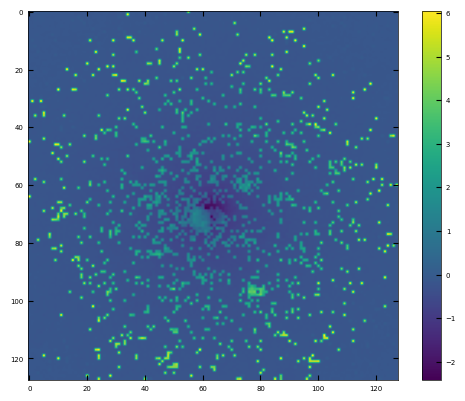

In [9]:
i,x = dset[8256]
plt.imshow(x)
plt.colorbar()

(16384, 56)
(65536, 56)
(16384, 56)
(16384, 58)
(16384, 55)
(16384, 54)
(16384, 54)
(16384, 52)
(16384, 56)
(65536, 57)
(65536, 54)
(16384, 60)
(16384, 55)
(65536, 57)
(65536, 50)
(16384, 59)
(16384, 58)
(16384, 47)
(65536, 48)
(65536, 70)
(16384, 56)
(16384, 61)
(16384, 61)
(16384, 64)
(16384, 64)
(16384, 61)
(16384, 62)
(16384, 57)
(16384, 62)
(16384, 59)
(16384, 62)
(16384, 57)
(16384, 54)
(16384, 57)
(16384, 55)
(65536, 56)
(65536, 74)
(65536, 47)
(16384, 58)
(16384, 57)
(65536, 58)
(16384, 61)
(16384, 62)
(16384, 62)
(16384, 65)
(16384, 65)
(16384, 65)
(16384, 65)
(65536, 60)
(16384, 66)
(16384, 66)
(16384, 62)
(16384, 64)
(16384, 66)
(16384, 65)
(16384, 65)
(65536, 64)
(16384, 64)
(16384, 61)
(16384, 61)
(65536, 59)
(16384, 62)
(16384, 64)
(16384, 63)
(16384, 63)
(16384, 63)
(65536, 59)
(16384, 64)
(16384, 63)
(16384, 61)
(65536, 60)
(16384, 59)
(16384, 60)
(65536, 63)
(16384, 63)
(16384, 60)
(16384, 61)
(65536, 60)
(65536, 67)
(16384, 62)
(16384, 61)
(16384, 62)
(16384, 63)
(163

IndexError: list index out of range

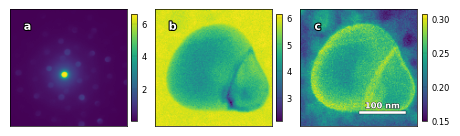

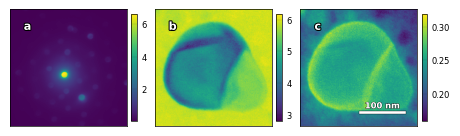

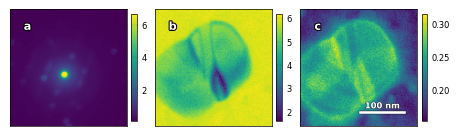

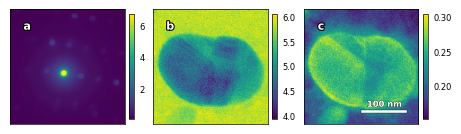

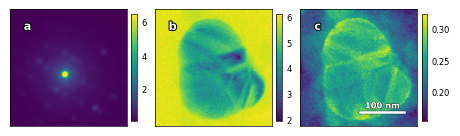

...

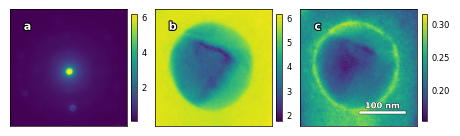

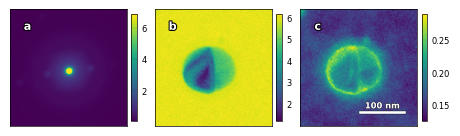

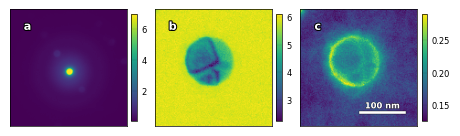

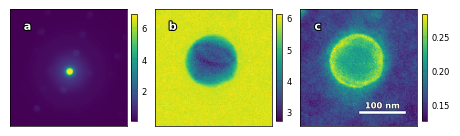

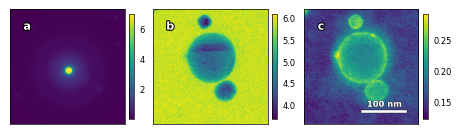

In [220]:
# # TODO: fix the bright/darkfield viz, and the avg. By Particle.
for i in range(len(dset)):
    viz.STEM_raw_and_virtual(
        dset,i,
        scalebar_=True,
    )

In [26]:
h = dset.open_h5()
data = h['processed_data']
data

<HDF5 dataset "processed_data": shape (3309568, 128, 128), type "<f8">

In [28]:
dset.meta.keys()

dict_keys(['path_list', 'particle_list', 'shape_list', 'particle_inds', 'sample_inds'])

In [53]:
test = data[dset.meta['particle_inds'][1]:dset.meta['particle_inds'][2]]
test.shape

(65536, 128, 128)

In [73]:
dset.meta['particle_inds'][124]

3309568

In [72]:
dset.meta['sample_inds']

[0, 31, 41, 92, 124]

In [191]:
mask_list = []
img_list = []
for i in tqdm(range(40,50)):
    start = dset.meta['particle_inds'][i]
    stop = dset.meta['particle_inds'][i+1]
    img = data[start:stop:25].mean(0)
    thresh = img.mean()+img.std()*7
    mask_list.append(np.argwhere(img>thresh).T)
    img_list.append(img)

  0%|          | 0/10 [00:00<?, ?it/s]

100%|██████████| 10/10 [00:00<00:00, 12.87it/s]


In [192]:
mask_list[0].shape

(2, 58)

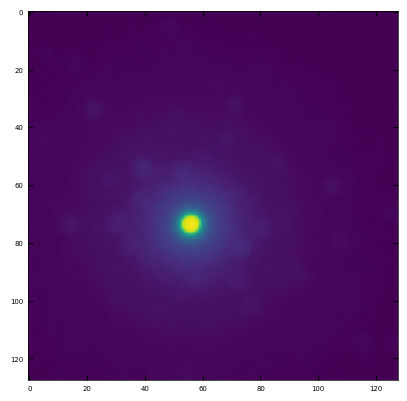

In [193]:
plt.imshow(img_list[0])

In [194]:
i=0
img_list[i][mask_list[i][0],mask_list[i][1]]=0

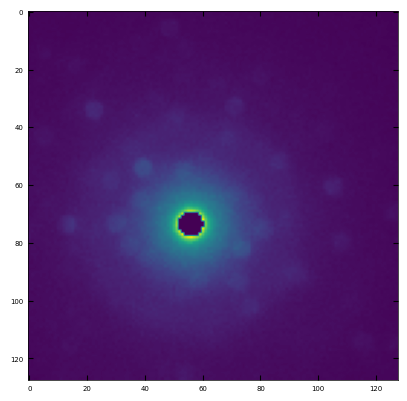

In [195]:
plt.imshow(img_list[i])

In [114]:
plt.imshow(img_list[i]*(1-mask_list[i]))

ValueError: operands could not be broadcast together with shapes (128,128) (50,2) 

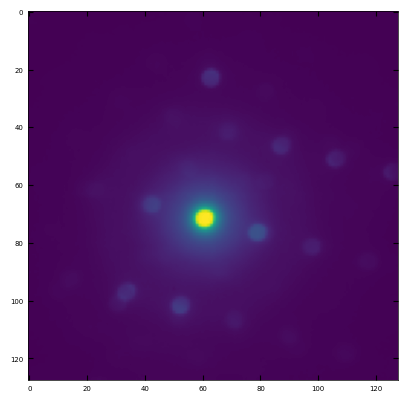

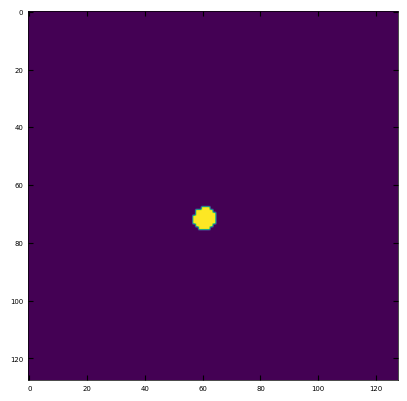

In [104]:
i=9
plt.Figure(figsize=(1,1))
plt.imshow(img_list[i])
plt.show()
plt.imshow(mask_list[i])
plt.show()

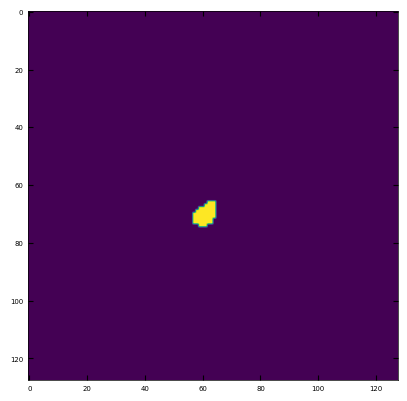

In [87]:
plt.imshow(mask_list[0])

In [12]:
# # TODO: Do masking by particle. Record location/radius
# # TODO: fix the bright/darkfield viz, and the avg. By Particle.
# # bright_field_ = bbox
# # # dark_field_ = (dx1,dx2,dy1,dy2)
# filename = "STEM_raw_and_virtual_particle_62"
# viz.STEM_raw_and_virtual(
#     domain,
#     # bright_field_=bright_field_,
#     dark_field_=dark_field_,
#     scalebar_=True,
#     datapath=f'{data_path}/SI data (*)',
#     shape_=domain.data.shape,
# )

### Builds the Neural Network Model


In [5]:
encoder_step_size = dset.shape[-2:]
pooling_list = [4, 2, 2]
decoder_step_size = [8, 8]
upsampling_list = [4, 4]
embedding_size = 32
conv_size = 128

# set device to load model
device = "cuda:0"

model = ConvAutoencoder(
    encoder_step_size=encoder_step_size,
    pooling_list=pooling_list,
    decoder_step_size=decoder_step_size,
    upsampling_list=upsampling_list,
    embedding_size=embedding_size,
    conv_size=conv_size,
    device=device,
    learning_rate=3e-5,
)


### Trains or Loads Pretrained Weights


In [21]:
h.close()

In [22]:
# set retrain parameter
train = True
if train:
    model.train=True
    for ep in np.arange(13,100,2):
        model.Train(
            dset,
            coef_1=5e-5*ep,
            coef_2=5e-5*ep,
            epoch_=ep,
            epochs=ep+2,
            with_scheduler=False,
            folder_path="Combined_all_samples",
            batch_size=32,
            save_emb_every=2
        )
else:
    model.load_weights(
        f'/home/m3learning/Northwestern/m3_learning/m3_learning/papers/HE_nanoparticles/Combined_all_samples/(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255.pkl'
    )

Epoch: 014/015, getting embedding
.............................
creating new embedding and affine h5 datasets
Created empty h5 embedding datasets to fill during training


100%|██████████| 103424/103424 [5:34:10<00:00,  5.16it/s] 


Epoch: 014/015 | Train Loss: 0.6243
.............................
Epoch: 016/017, getting embedding
.............................
creating new embedding and affine h5 datasets
Created empty h5 embedding datasets to fill during training


100%|██████████| 103424/103424 [5:28:09<00:00,  5.25it/s] 


Epoch: 016/017 | Train Loss: 0.6245
.............................
Epoch: 018/019, getting embedding
.............................
creating new embedding and affine h5 datasets
Created empty h5 embedding datasets to fill during training


100%|██████████| 103424/103424 [5:20:09<00:00,  5.38it/s] 


Epoch: 018/019 | Train Loss: 0.6247
.............................
Epoch: 020/021, getting embedding
.............................
creating new embedding and affine h5 datasets
Created empty h5 embedding datasets to fill during training


100%|██████████| 103424/103424 [5:22:42<00:00,  5.34it/s] 


Epoch: 020/021 | Train Loss: 0.6249
.............................
Epoch: 022/023, getting embedding
.............................
creating new embedding and affine h5 datasets
Created empty h5 embedding datasets to fill during training


  0%|          | 81/103424 [00:15<5:24:27,  5.31it/s]


KeyboardInterrupt: 

### Computes the Embeddings


In [7]:
model.checkpoint

'/home/m3learning/Northwestern/m3_learning/m3_learning/papers/HE_nanoparticles/Combined_all_samples/(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255.pkl'

In [9]:
# # run if you did not autosave embedding (takes about 50 minutes on h100, or 2.5 hr on titan)
# model.get_embedding(dset,train=False)

### Visualizes the Embeddings


In [25]:
hemb = model.open_embedding_h()

In [26]:
list(hemb.keys())

['embedding_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'embedding_(2023-10-11)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6243',
 'embedding_(2023-10-12)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6245',
 'embedding_(2023-10-12)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6247',
 'embedding_(2023-10-12)_epoch:0020_l1coef:0.0009_lr:0.00003_trainloss:0.6249',
 'embedding_temp',
 'rotation_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'rotation_(2023-10-11)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6243',
 'rotation_(2023-10-12)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6245',
 'rotation_(2023-10-12)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6247',
 'rotation_(2023-10-12)_epoch:0020_l1coef:0.0009_lr:0.00003_trainloss:0.6249',
 'rotation_temp',
 'scaleshear_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'scaleshear_(2023-10-11)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6243',
 'scal

  0%|          | 0/124 [00:00<?, ?it/s]

./../../Northwestern_Figures/emb_affine_epoch_20/


  1%|          | 1/124 [00:06<14:08,  6.90s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  2%|▏         | 2/124 [00:14<14:17,  7.03s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  2%|▏         | 3/124 [00:20<13:59,  6.94s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  3%|▎         | 4/124 [00:27<13:58,  6.98s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  4%|▍         | 5/124 [00:34<13:45,  6.94s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  5%|▍         | 6/124 [00:41<13:34,  6.91s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  6%|▌         | 7/124 [00:48<13:24,  6.87s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  6%|▋         | 8/124 [00:55<13:16,  6.86s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  7%|▋         | 9/124 [01:02<13:15,  6.92s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  8%|▊         | 10/124 [01:09<13:16,  6.99s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


  9%|▉         | 11/124 [01:16<13:14,  7.03s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 10%|▉         | 12/124 [01:23<13:02,  6.99s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 10%|█         | 13/124 [01:30<12:51,  6.95s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 11%|█▏        | 14/124 [01:37<12:52,  7.02s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 12%|█▏        | 15/124 [01:44<12:51,  7.08s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 13%|█▎        | 16/124 [01:51<12:40,  7.05s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 14%|█▎        | 17/124 [01:58<12:27,  6.99s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 15%|█▍        | 18/124 [02:06<12:45,  7.22s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 15%|█▌        | 19/124 [02:13<12:36,  7.20s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 16%|█▌        | 20/124 [02:20<12:18,  7.11s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 17%|█▋        | 21/124 [02:27<12:13,  7.12s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 18%|█▊        | 22/124 [02:34<11:58,  7.05s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 19%|█▊        | 23/124 [02:40<11:37,  6.91s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 19%|█▉        | 24/124 [02:48<11:36,  6.97s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 20%|██        | 25/124 [02:54<11:25,  6.92s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 21%|██        | 26/124 [03:01<11:08,  6.82s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 22%|██▏       | 27/124 [03:08<11:09,  6.90s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 23%|██▎       | 28/124 [03:15<11:00,  6.88s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 23%|██▎       | 29/124 [03:21<10:43,  6.78s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 24%|██▍       | 30/124 [03:29<10:48,  6.90s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 25%|██▌       | 31/124 [03:35<10:32,  6.80s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 26%|██▌       | 32/124 [03:42<10:35,  6.91s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 27%|██▋       | 33/124 [03:49<10:26,  6.89s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 27%|██▋       | 34/124 [03:56<10:19,  6.88s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 28%|██▊       | 35/124 [04:03<10:05,  6.80s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 29%|██▉       | 36/124 [04:10<10:14,  6.99s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 30%|██▉       | 37/124 [04:17<10:05,  6.96s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 31%|███       | 38/124 [04:24<10:11,  7.11s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 31%|███▏      | 39/124 [04:31<09:58,  7.04s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 32%|███▏      | 40/124 [04:38<09:39,  6.89s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 33%|███▎      | 41/124 [04:45<09:44,  7.04s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 34%|███▍      | 42/124 [04:52<09:26,  6.90s/it]

./../../Northwestern_Figures/emb_affine_epoch_20/


 34%|███▍      | 42/124 [04:56<09:38,  7.05s/it]


KeyboardInterrupt: 

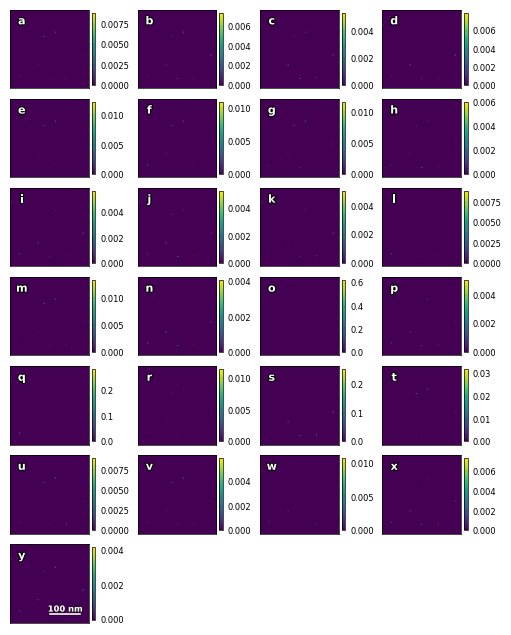

In [28]:
viz.channels = [i for i in range(32) if (model.embedding[:,i]).any()]
viz.scalebar_ = {"width": 250, "scale length": 100, "units": "nm"}
viz.model = model
viz.embeddings(
    dset.meta,
    mod=4,
    scalebar_=viz.scalebar_,
    figsize=(5, 8),
    savefolder='emb_affine_epoch_20/',
    )

In [30]:
# Visualize affine transforms
viz.affines(
    dset.meta,
    scalebar_=viz.scalebar_,
    figsize=(5, 8),
    savefolder='emb_affine_epoch_20/'
    )

  0%|          | 0/124 [00:00<?, ?it/s]

100%|██████████| 124/124 [03:46<00:00,  1.83s/it]


### Cluster embedding

In [23]:
h = model.open_embedding_h()
list(h.keys())

['embedding_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'embedding_(2023-10-11)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6243',
 'embedding_(2023-10-12)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6245',
 'embedding_(2023-10-12)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6247',
 'embedding_(2023-10-12)_epoch:0020_l1coef:0.0009_lr:0.00003_trainloss:0.6249',
 'embedding_temp',
 'rotation_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'rotation_(2023-10-11)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6243',
 'rotation_(2023-10-12)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6245',
 'rotation_(2023-10-12)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6247',
 'rotation_(2023-10-12)_epoch:0020_l1coef:0.0009_lr:0.00003_trainloss:0.6249',
 'rotation_temp',
 'scaleshear_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'scaleshear_(2023-10-11)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6243',
 'scal

In [24]:
hg = model.open_generated_h()
list(hg.keys())

['(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255']

In [29]:
scaled_emb_affines = model.stack_emb_affines()

PCA with 24 components...
Getting elbow plot...


100%|██████████| 29/29 [00:42<00:00,  1.47s/it]


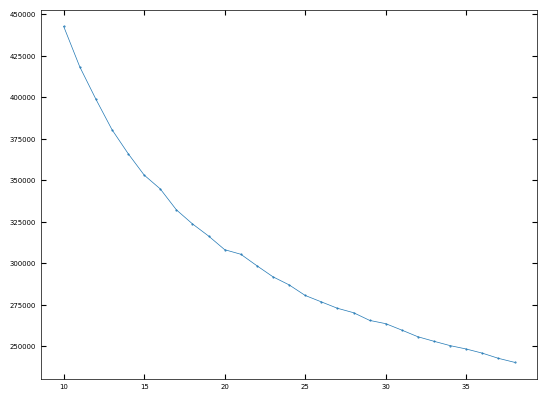

Clustering with 20 clusters...


In [43]:
# will create scree and elbow plots if you aren't sure how many components/clusters are needed

cluster_list,labels = model.get_clusters(dset,scaled_emb_affines,n_components=24,n_clusters=20)

### Visualize clusters

100%|██████████| 124/124 [00:59<00:00,  2.08it/s]


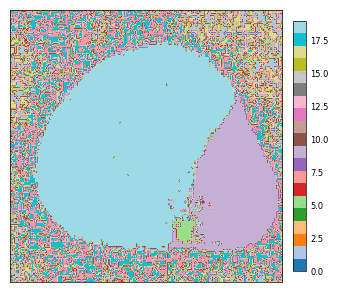

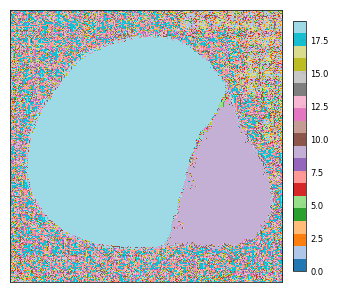

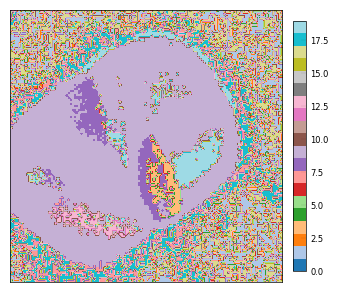

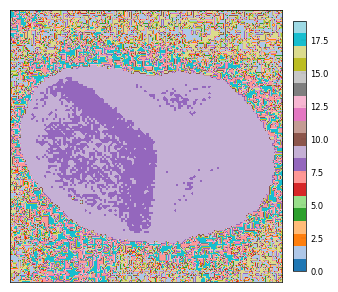

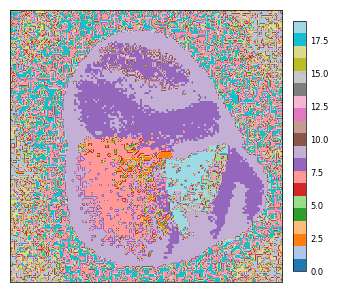

...

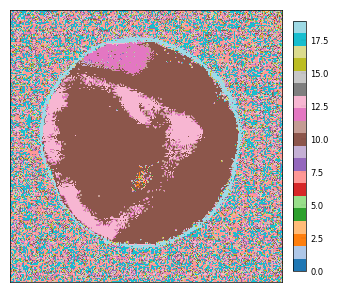

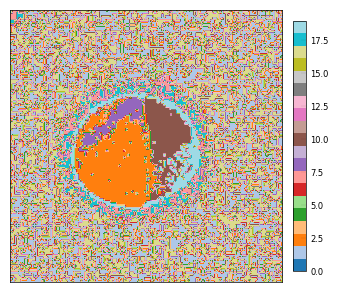

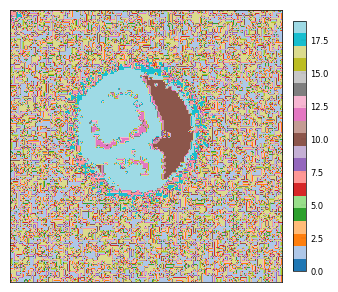

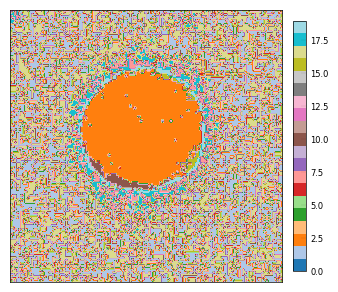

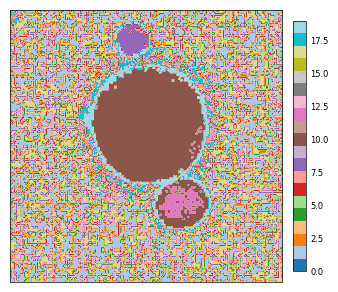

In [39]:
viz.clustered_images(dset,cluster_list,
                     save_folder='clustered_20/',
                     printer = viz.printer)

### Old clustering

In [39]:
from sklearn.decomposition import PCA
from tqdm import tqdm
from sklearn.cluster import KMeans
from viz.nn import get_theta

In [40]:
h = h5py.File(model.emb_h5_path,'r+')
list(h.keys())

['embedding_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'embedding_(2023-10-10)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6260',
 'embedding_(2023-10-11)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6256',
 'embedding_(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255',
 'embedding_temp',
 'rotation_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'rotation_(2023-10-10)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6260',
 'rotation_(2023-10-11)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6256',
 'rotation_(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255',
 'rotation_temp',
 'scaleshear_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'scaleshear_(2023-10-10)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6260',
 'scaleshear_(2023-10-11)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6256',
 'scaleshear_(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255',
 's

In [42]:
check = '(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255'

In [43]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [44]:
emblist = [h['embedding_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227'][:,i].reshape(-1,1) for i in range(32)]

In [46]:
scaled_embs = list(map(scaler.fit_transform,emblist))

In [47]:
scaled_embs[0].shape

(3309568, 1)

In [48]:
# embdata = scaler.fit_transform(h['embedding_(2023-08-21)_epoch:0006_l1coef:0.0000_lr:0.00003_trainloss:0.6229'])
rotation = scaler.fit_transform(get_theta(h[f'rotation_{check}']).reshape(-1,1))
translationx = scaler.fit_transform(h[f'translation_{check}'][:,2].reshape(-1,1))
translationy = scaler.fit_transform(h[f'translation_{check}'][:,5].reshape(-1,1))
scalex = scaler.fit_transform(h[f'scaleshear_{check}'][:,0].reshape(-1,1))
shearx = scaler.fit_transform(h[f'scaleshear_{check}'][:,1].reshape(-1,1))
scaley = scaler.fit_transform(h[f'scaleshear_{check}'][:,4].reshape(-1,1))
shearx = scaler.fit_transform(h[f'scaleshear_{check}'][:,3].reshape(-1,1))

In [49]:
scaled_embs+=[rotation,translationx,translationy,scalex,shearx,scaley,shearx]

In [50]:
scaled_array = np.stack(scaled_embs,axis=1).squeeze()

In [51]:
scaled_array.shape

(3309568, 39)

#### translation

In [65]:
pca = PCA()
transformed = pca.fit_transform(scaled)
transformed.shape
plt.scatter(transformed[:,0],transformed[:,1])

(3309568, 2)

  0%|          | 0/27 [00:00<?, ?it/s]

100%|██████████| 27/27 [00:30<00:00,  1.13s/it]


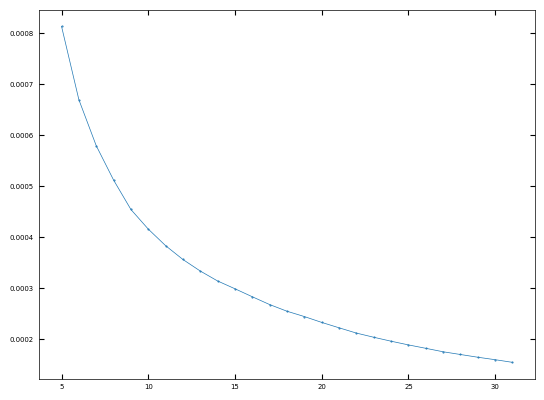

In [67]:
wcss = []
for i in tqdm(range(5,32)):
    kmeans_pca = KMeans(n_clusters=i,init='k-means++',random_state=42)
    kmeans_pca.fit(transformed[::100])
    wcss.append(kmeans_pca.inertia_)
plt.plot(range(5,32),wcss,marker='o')

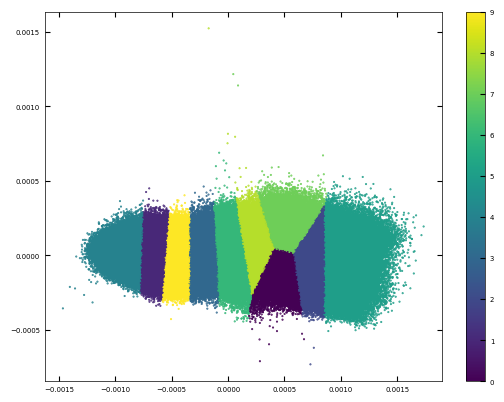

In [68]:
kmeans_pca = KMeans(n_clusters=10,init='k-means++',random_state=42)
kmeans_pca.fit(transformed)
plt.scatter(transformed[:,0],transformed[:,1],c=kmeans_pca.labels_)
plt.colorbar()

#### rotation

 19%|█▊        | 5/27 [00:00<00:02,  7.39it/s]

100%|██████████| 27/27 [00:05<00:00,  4.85it/s]


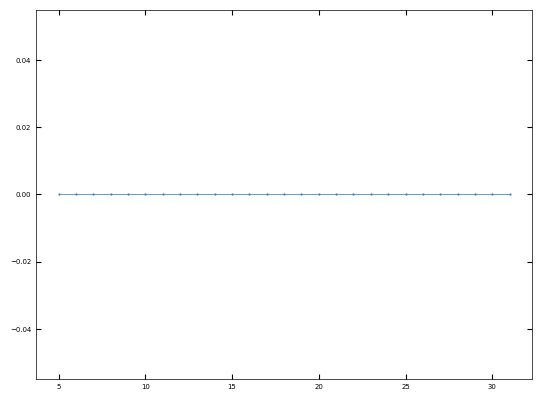

In [83]:
wcss = []
for i in tqdm(range(5,32)):
    kmeans_pca = KMeans(n_clusters=i,init='k-means++',random_state=42)
    kmeans_pca.fit(rotation[::100])
    wcss.append(kmeans_pca.inertia_)
plt.plot(range(5,32),wcss,marker='o')

In [84]:
rotation.shape

(3309568, 1)

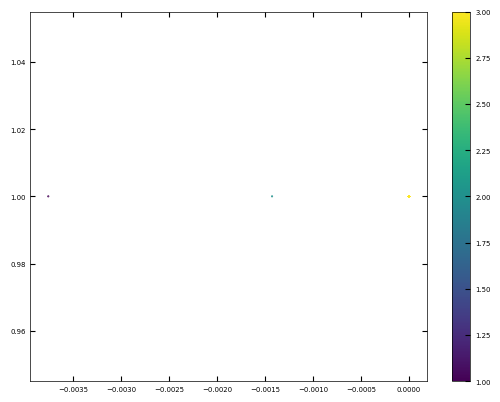

In [89]:
kmeans = KMeans(n_clusters=5,init='k-means++',random_state=42)
kmeans_pca.fit(rotation)
plt.scatter(rotation[:,0],np.zeros(rotation.shape[0]),c=kmeans_pca.labels_)
plt.colorbar()

#### embedding

In [ ]:
pca = PCA()
pca.fit(embdata)
plt.plot(pca.explained_variance_ratio_.cumsum(),marker='o')

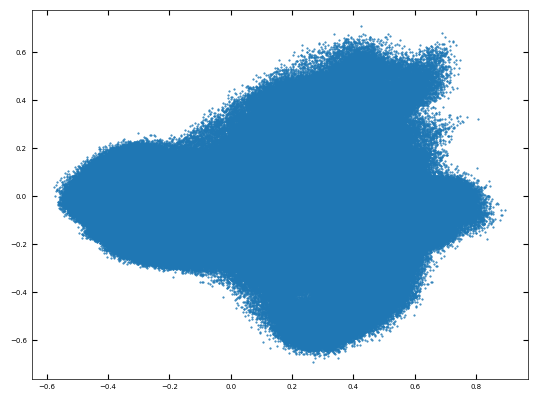

In [28]:
pca = PCA(10)
transformed = pca.fit_transform(embdata)
plt.scatter(transformed[:,0],transformed[:,1])

In [34]:
wcss = []
for i in tqdm(range(5,32)):
    kmeans_pca = KMeans(n_clusters=i,init='k-means++',random_state=42)
    kmeans_pca.fit(transformed[::100])
    wcss.append(kmeans_pca.inertia_)
plt.plot(range(5,32),wcss,marker='o')

  0%|          | 0/27 [00:00<?, ?it/s]

100%|██████████| 27/27 [00:46<00:00,  1.71s/it]


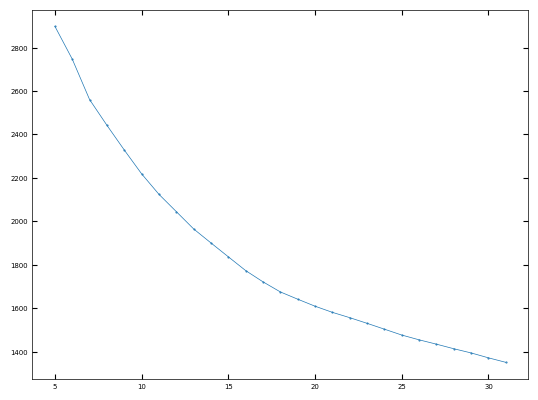

In [35]:
plt.plot(range(5,32),wcss,marker='o')

KeyboardInterrupt: 

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 177, in where
KeyboardInterrupt: 


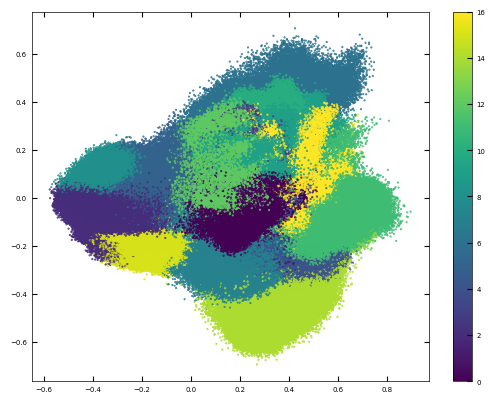

In [36]:
kmeans_pca = KMeans(n_clusters=17,init='k-means++',random_state=42)
kmeans_pca.fit(transformed)
plt.scatter(transformed[:,0],transformed[:,1],c=kmeans_pca.labels_)
plt.colorbar()

In [30]:
plt.scatter(transformed[:,0],transformed[:,1],c=kmeans_pca.labels_)
plt.colorbar()

Error in callback <function _draw_all_if_interactive at 0x7f4cf6794c20> (for post_execute):


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f4c2e050c20> (for post_execute):


KeyboardInterrupt: 

In [32]:
transformed.shape

(3309568, 10)

In [33]:
dset.meta.keys()

dict_keys(['path_list', 'particle_list', 'shape_list', 'particle_inds', 'sample_inds'])

In [38]:
kmeans_pca.labels_.shape

(3309568,)

In [44]:
cluster_list = []
for i,particle in enumerate(dset.meta['particle_list']):
    img = kmeans_pca.labels_[dset.meta['particle_inds'][i]:dset.meta['particle_inds'][i+1] ].reshape(dset.meta['shape_list'][i][0],dset.meta['shape_list'][i][1])
    cluster_list.append(img)

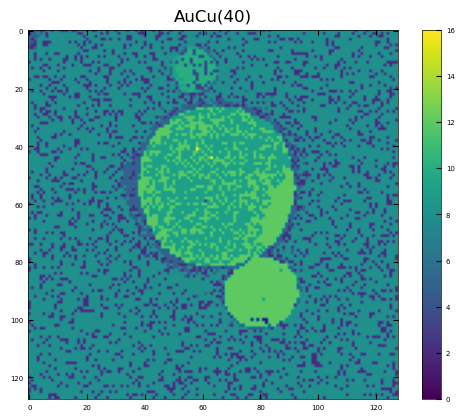

In [49]:
for i,particle in enumerate(dset.meta['particle_list']):
    # img = kmeans_pca.labels_[dset.meta['particle_inds'][i]:dset.meta['particle_inds'][i+1] ].reshape(dset.meta['shape_list'][i][0],dset.meta['shape_list'][i][1])
    # cluster_list.append(img)
    plt.clf()
    plt.imshow(cluster_list[i])
    plt.colorbar()
    plt.title(particle)
    plt.savefig(f'./clustering/{particle}',facecolor='white',dpi=200)
    # print(img.shape?\)
    
    # plt.imshow(transformed[i:i+1])


In [45]:
def f(i):
    plt.imshow(cluster_list[i])
    plt.colorbar()
    plt.title(dset.meta['particle_list'][i])
    
interact(f,i=(0,len(dset.meta['particle_list'])-1))

interactive(children=(IntSlider(value=61, description='i', max=123), Output()), _dom_classes=('widget-interact…

<function __main__.f(i)>

#### embedding affine scaled and stacked

In [52]:
# pca = PCA()
# pca.fit(scaled_array)
# plt.plot(pca.explained_variance_ratio_.cumsum(),marker='o')

In [53]:
pca = PCA(24)
transformed = pca.fit_transform(scaled_array)
# plt.scatter(transformed[:,0],transformed[:,1])

In [54]:
# wcss = []
# for i in tqdm(range(5,39)):
#     kmeans_pca = KMeans(n_clusters=i,init='k-means++',random_state=42)
#     kmeans_pca.fit(transformed[::100])
#     wcss.append(kmeans_pca.inertia_)
# plt.plot(range(5,39),wcss,marker='o')

In [55]:
kmeans_pca = KMeans(n_clusters=20,init='k-means++',random_state=42)
kmeans_pca.fit(transformed)
# plt.scatter(transformed[:,0],transformed[:,1],c=kmeans_pca.labels_)
# plt.colorbar()

KMeans(n_clusters=20, random_state=42)

In [56]:
cluster_list = []
for i,particle in enumerate(dset.meta['particle_list']):
    img = kmeans_pca.labels_[dset.meta['particle_inds'][i]:dset.meta['particle_inds'][i+1] ].reshape(dset.meta['shape_list'][i][0],dset.meta['shape_list'][i][1])
    cluster_list.append(img)

In [28]:
np.unique(kmeans_pca.labels_)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19], dtype=int32)

  0%|          | 0/124 [00:00<?, ?it/s]

100%|██████████| 124/124 [00:24<00:00,  5.00it/s]


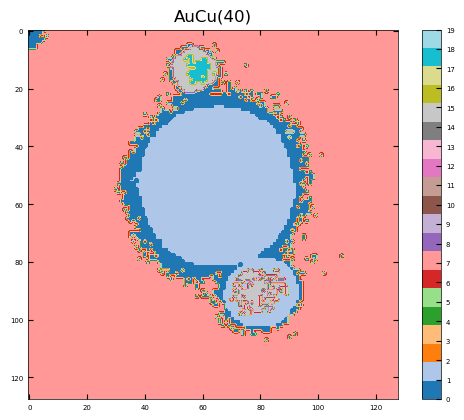

In [57]:
# colors = iter([plt.cm.tab20(i) for i in range(20)])
for i,particle in enumerate(tqdm(dset.meta['particle_list'])):
    # img = kmeans_pca.labels_[dset.meta['particle_inds'][i]:dset.meta['particle_inds'][i+1] ].reshape(dset.meta['shape_list'][i][0],dset.meta['shape_list'][i][1])
    # cluster_list.append(img)
    plt.clf()
    plt.imshow(cluster_list[i],vmin=0,vmax=19,cmap='tab20')
    cbar = plt.colorbar()
    cbar.set_ticks(np.arange(0,20))
    cbar.set_ticklabels(np.arange(20))
    plt.title(particle)
    plt.savefig(f'./clustering_emb_affine_epoch_18/{particle}',facecolor='white',dpi=200)
    # print(img.shape?\)
    
    # plt.imshow(transformed[i:i+1])


In [63]:
def f(i):
    plt.imshow(cluster_list[i])
    plt.colorbar()
    plt.title(dset.meta['particle_list'][i])
    
interact(f,i=(0,len(dset.meta['particle_list'])-1))

interactive(children=(IntSlider(value=61, description='i', max=123), Output()), _dom_classes=('widget-interact…

<function __main__.f(i)>

### cluster by image

In [13]:
dset.meta.keys()

dict_keys(['path_list', 'particle_list', 'shape_list', 'particle_inds', 'sample_inds'])

In [14]:
dset.meta['sample_inds']

[0, 31, 41, 92, 124]

In [15]:
emb_128_shape =[] # list of (32, 128*128) flattened imgs
for i,shape in enumerate(dset.meta['shape_list']):
    if shape[0] is not 128: continue
    emb_128_shape.append(embdata[dset.meta['particle_inds'][i]:dset.meta['particle_inds'][i+1]].reshape(-1,32).T) 
emb_imgs = np.array([[img[i] for img in emb_128_shape] for i in range(32)]).reshape(-1,128*128)

In [8]:
emb_imgs.shape

NameError: name 'emb_imgs' is not defined

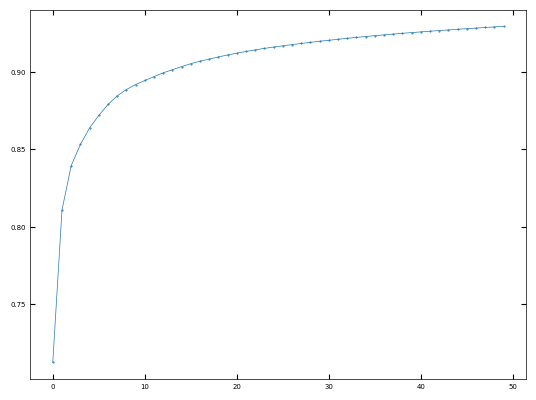

In [49]:
pca = PCA(50)
pca.fit(emb_imgs)
plt.plot(pca.explained_variance_ratio_.cumsum(),marker='o')

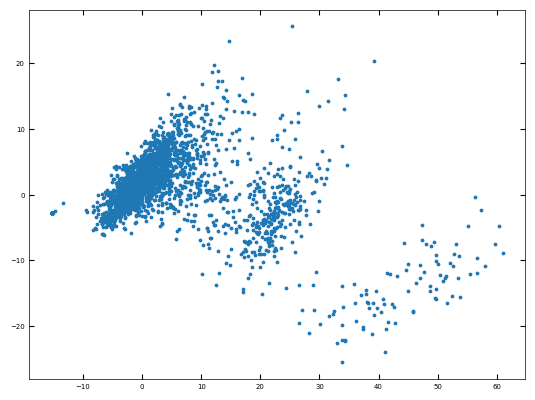

In [16]:
pca = PCA(12)
transformed = pca.fit_transform(emb_imgs)
plt.scatter(transformed[:,0],transformed[:,1],s=3)

  0%|          | 0/45 [00:00<?, ?it/s]

100%|██████████| 45/45 [00:07<00:00,  6.13it/s]


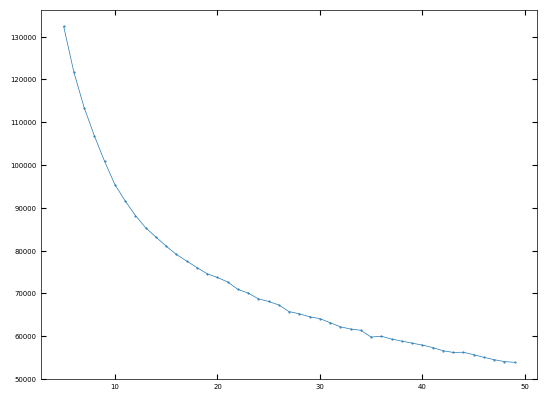

In [52]:
wcss = []
for i in tqdm(range(5,50)):
    kmeans_pca = KMeans(n_clusters=i,init='k-means++',random_state=42)
    kmeans_pca.fit(transformed)
    wcss.append(kmeans_pca.inertia_)
plt.plot(range(5,50),wcss,marker='o')

In [17]:
kmeans_pca = KMeans(n_clusters=16,init='k-means++',random_state=42)
kmeans_pca.fit(transformed)

KMeans(n_clusters=16, random_state=42)

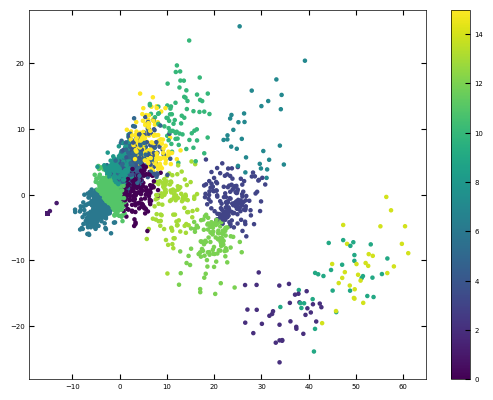

In [62]:
plt.scatter(transformed[:,0],transformed[:,1],c=kmeans_pca.labels_,s=5)
plt.colorbar()

In [18]:
labels0 = np.argwhere(kmeans_pca.labels_==0)

In [19]:
emb_ch_0 = labels0%32

In [20]:
emb_ch_0.shape

(194, 1)

In [21]:
imgs_0 = emb_imgs[labels0].squeeze()

In [22]:
import ipywidgets

In [23]:
labels_inds = np.argwhere(kmeans_pca.labels_==5)
emb_ch = labels_inds%32
imgs = emb_imgs[labels_inds].squeeze()
emb_counts = np.array(np.unique(emb_ch,return_counts=True)).T

In [25]:


def f(i):
    plt.imshow(imgs[i].reshape(128,128))
    plt.title(f'channel {emb_ch[i]}')
    
interact(f,i=(0,len(imgs)-1))

interactive(children=(IntSlider(value=79, description='i', max=159), Output()), _dom_classes=('widget-interact…

<function __main__.f(i)>

### Generates Data


In [58]:
model.embedding.shape

(3309568, 32)

In [30]:
len(dset)

3309568

In [59]:
h = h5py.File(model.emb_h5_path,'r+')
list(h.keys())

['embedding_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'embedding_(2023-10-10)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6260',
 'embedding_(2023-10-11)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6256',
 'embedding_(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255',
 'embedding_temp',
 'rotation_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'rotation_(2023-10-10)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6260',
 'rotation_(2023-10-11)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6256',
 'rotation_(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255',
 'rotation_temp',
 'scaleshear_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227',
 'scaleshear_(2023-10-10)_epoch:0014_l1coef:0.0007_lr:0.00003_trainloss:0.6260',
 'scaleshear_(2023-10-11)_epoch:0016_l1coef:0.0008_lr:0.00003_trainloss:0.6256',
 'scaleshear_(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255',
 's

In [32]:
# model.embedding = h[f'embedding_{check}']


In [33]:
# checkpoint = '/home/m3learning/Northwestern/m3_learning/m3_learning/papers/HE_nanoparticles/Combined_all_samples/(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227.pkl'


# embedding = model.embedding
# channels = []
# for i in range(32):
#     if embedding[:,i].max()>0.03: channels.append(i)
# channels

viz.channels = [i for i in range(32) if (model.embedding[:,i]).any()]
# ranges = []
# for c in channels:
#     ranges.append([embedding[:,c].min(),embedding[:,c].max()])
    
# model.embedding = embedding
viz.model = model
# folder_name = "Generator_of_epoch_6_all_ch"

In [34]:
model.load_weights(checkpoint)

Unable to open file (bad object header version number)
Generated not opened


In [35]:
model.train=False

In [36]:
# # folder_name = "Generator_of_epoch_6_all_ch"
# model.generate_by_range(dset.meta, checkpoint,channels=viz.channels,
#                                 generator_iters=25,averaging_number=50,
#                                 overwrite=True)

In [37]:
model.embedding

<HDF5 dataset "embedding_(2023-10-02)_epoch:0013_l1coef:0.0001_lr:0.00003_trainloss:0.6227": shape (3309568, 32), type "<f8">

#### Generate by labels

In [61]:
labels = kmeans_pca.labels_
len(labels)

3309568

In [ ]:
np.at

In [62]:
model.generated

AttributeError: 'ConvAutoencoder' object has no attribute 'generated'

In [63]:
model.train = False
model.generate_by_labels(dset.meta, labels,channels=viz.channels,
                                generator_iters=50,overwrite=True)

(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255
0 AgCu(1)


100%|██████████| 20/20 [00:00<00:00, 78.82it/s]


1 AgCu(2)


100%|██████████| 20/20 [00:00<00:00, 252.38it/s]


2 AgCu(3)


100%|██████████| 20/20 [00:00<00:00, 270.35it/s]


3 AgCu(5)


100%|██████████| 20/20 [00:00<00:00, 286.00it/s]


4 AgCu(6)


100%|██████████| 20/20 [00:00<00:00, 260.46it/s]


5 AgCu(9)


100%|██████████| 20/20 [00:00<00:00, 275.90it/s]


6 AgCu(10)


100%|██████████| 20/20 [00:00<00:00, 283.01it/s]


7 AgCu(11)


100%|██████████| 20/20 [00:00<00:00, 266.31it/s]


8 AgCu(13)


100%|██████████| 20/20 [00:00<00:00, 288.46it/s]


9 AgCu(14)


100%|██████████| 20/20 [00:00<00:00, 203.46it/s]


10 AgCu(15)


100%|██████████| 20/20 [00:00<00:00, 262.49it/s]


11 AgCu(16)


100%|██████████| 20/20 [00:00<00:00, 289.22it/s]


12 AgCu(17)


100%|██████████| 20/20 [00:00<00:00, 212.38it/s]


13 AgCu(18)


100%|██████████| 20/20 [00:00<00:00, 274.63it/s]


14 AgCu(19)


100%|██████████| 20/20 [00:00<00:00, 214.22it/s]


15 AgCu(20)


100%|██████████| 20/20 [00:00<00:00, 214.89it/s]


16 AgCu(21)


100%|██████████| 20/20 [00:00<00:00, 220.24it/s]


17 AgCu(22)


100%|██████████| 20/20 [00:00<00:00, 200.12it/s]


18 AgCu(23)


100%|██████████| 20/20 [00:00<00:00, 196.42it/s]


19 AgCu(24)


100%|██████████| 20/20 [00:00<00:00, 224.37it/s]


20 AgCu(26)


100%|██████████| 20/20 [00:00<00:00, 226.67it/s]


21 AgCu(41)


100%|██████████| 20/20 [00:00<00:00, 211.17it/s]


22 AgCu(42)


100%|██████████| 20/20 [00:00<00:00, 233.03it/s]


23 AgCu(43)


100%|██████████| 20/20 [00:00<00:00, 234.37it/s]


24 AgCu(44)


100%|██████████| 20/20 [00:00<00:00, 221.09it/s]


25 AgCu(45)


100%|██████████| 20/20 [00:00<00:00, 236.66it/s]


26 AgCu(46)


100%|██████████| 20/20 [00:00<00:00, 237.23it/s]


27 AgCu(48)


100%|██████████| 20/20 [00:00<00:00, 206.41it/s]


28 AgCu(50)


100%|██████████| 20/20 [00:00<00:00, 235.44it/s]


29 AgCu(53)


100%|██████████| 20/20 [00:00<00:00, 233.06it/s]


30 AgCu(54)


100%|██████████| 20/20 [00:00<00:00, 278.30it/s]


31 Au30Ag10Co20Ni40(62)


100%|██████████| 20/20 [00:00<00:00, 275.88it/s]


32 Au30Ag10Co20Ni40(63)


100%|██████████| 20/20 [00:00<00:00, 278.32it/s]


33 Au30Ag10Co20Ni40(64)


100%|██████████| 20/20 [00:00<00:00, 209.91it/s]


34 Au30Ag10Co20Ni40(65)


100%|██████████| 20/20 [00:00<00:00, 279.21it/s]


35 Au30Ag10Co20Ni40(66)


100%|██████████| 20/20 [00:00<00:00, 245.10it/s]


36 Au30Ag10Co20Ni40(67)


100%|██████████| 20/20 [00:00<00:00, 242.84it/s]


37 Au30Ag10Co20Ni40(68)


100%|██████████| 20/20 [00:00<00:00, 275.42it/s]


38 Au30Ag10Co20Ni40(69)


100%|██████████| 20/20 [00:00<00:00, 173.88it/s]


39 Au30Ag10Co20Ni40(70)


100%|██████████| 20/20 [00:00<00:00, 175.22it/s]


40 Au30Ag10Co20Ni40(71)


100%|██████████| 20/20 [00:00<00:00, 211.31it/s]


41 Au30Cu20Co20Ni30(1)


100%|██████████| 20/20 [00:00<00:00, 223.29it/s]


42 Au30Cu20Co20Ni30(2)


100%|██████████| 20/20 [00:00<00:00, 212.34it/s]


43 Au30Cu20Co20Ni30(6)


100%|██████████| 20/20 [00:00<00:00, 197.18it/s]


44 Au30Cu20Co20Ni30(7)


100%|██████████| 20/20 [00:00<00:00, 188.88it/s]


45 Au30Cu20Co20Ni30(8)


100%|██████████| 20/20 [00:00<00:00, 202.58it/s]


46 Au30Cu20Co20Ni30(9)


100%|██████████| 20/20 [00:00<00:00, 208.76it/s]


47 Au30Cu20Co20Ni30(10)


100%|██████████| 20/20 [00:00<00:00, 147.35it/s]


48 Au30Cu20Co20Ni30(11)


100%|██████████| 20/20 [00:00<00:00, 225.64it/s]


49 Au30Cu20Co20Ni30(12)


100%|██████████| 20/20 [00:00<00:00, 178.92it/s]


50 Au30Cu20Co20Ni30(13)


100%|██████████| 20/20 [00:00<00:00, 195.43it/s]


51 Au30Cu20Co20Ni30(14)


100%|██████████| 20/20 [00:00<00:00, 209.30it/s]


52 Au30Cu20Co20Ni30(15)


100%|██████████| 20/20 [00:00<00:00, 211.13it/s]


53 Au30Cu20Co20Ni30(16)


100%|██████████| 20/20 [00:00<00:00, 184.82it/s]


54 Au30Cu20Co20Ni30(17)


100%|██████████| 20/20 [00:00<00:00, 195.80it/s]


55 Au30Cu20Co20Ni30(18)


100%|██████████| 20/20 [00:00<00:00, 190.43it/s]


56 Au30Cu20Co20Ni30(19)


100%|██████████| 20/20 [00:00<00:00, 207.87it/s]


57 Au30Cu20Co20Ni30(20)


100%|██████████| 20/20 [00:00<00:00, 185.35it/s]


58 Au30Cu20Co20Ni30(21)


100%|██████████| 20/20 [00:00<00:00, 164.69it/s]


59 Au30Cu20Co20Ni30(22)


100%|██████████| 20/20 [00:00<00:00, 191.15it/s]


60 Au30Cu20Co20Ni30(23)


100%|██████████| 20/20 [00:00<00:00, 212.63it/s]


61 Au30Cu20Co20Ni30(24)


100%|██████████| 20/20 [00:00<00:00, 235.81it/s]


62 Au30Cu20Co20Ni30(25)


100%|██████████| 20/20 [00:00<00:00, 237.19it/s]


63 Au30Cu20Co20Ni30(27)


100%|██████████| 20/20 [00:00<00:00, 135.29it/s]


64 Au30Cu20Co20Ni30(28)


100%|██████████| 20/20 [00:00<00:00, 224.52it/s]


65 Au30Cu20Co20Ni30(29)


100%|██████████| 20/20 [00:00<00:00, 228.28it/s]


66 Au30Cu20Co20Ni30(30)


100%|██████████| 20/20 [00:00<00:00, 259.40it/s]


67 Au30Cu20Co20Ni30(31)


100%|██████████| 20/20 [00:00<00:00, 220.06it/s]


68 Au30Cu20Co20Ni30(32)


100%|██████████| 20/20 [00:00<00:00, 228.08it/s]


69 Au30Cu20Co20Ni30(33)


100%|██████████| 20/20 [00:00<00:00, 224.18it/s]


70 Au30Cu20Co20Ni30(34)


100%|██████████| 20/20 [00:00<00:00, 227.06it/s]


71 Au30Cu20Co20Ni30(35)


100%|██████████| 20/20 [00:00<00:00, 219.04it/s]


72 Au30Cu20Co20Ni30(36)


100%|██████████| 20/20 [00:00<00:00, 195.95it/s]


73 Au30Cu20Co20Ni30(37)


100%|██████████| 20/20 [00:00<00:00, 192.62it/s]


74 Au30Cu20Co20Ni30(38)


100%|██████████| 20/20 [00:00<00:00, 233.41it/s]


75 Au30Cu20Co20Ni30(40)


100%|██████████| 20/20 [00:00<00:00, 229.14it/s]


76 Au30Cu20Co20Ni30(41)


100%|██████████| 20/20 [00:00<00:00, 231.69it/s]


77 Au30Cu20Co20Ni30(42)


100%|██████████| 20/20 [00:00<00:00, 263.82it/s]


78 Au30Cu20Co20Ni30(43)


100%|██████████| 20/20 [00:00<00:00, 271.97it/s]


79 Au30Cu20Co20Ni30(44)


100%|██████████| 20/20 [00:00<00:00, 230.83it/s]


80 Au30Cu20Co20Ni30(45)


100%|██████████| 20/20 [00:00<00:00, 229.86it/s]


81 Au30Cu20Co20Ni30(46)


100%|██████████| 20/20 [00:00<00:00, 229.92it/s]


82 Au30Cu20Co20Ni30(49)


100%|██████████| 20/20 [00:00<00:00, 230.71it/s]


83 Au30Cu20Co20Ni30(50)


100%|██████████| 20/20 [00:00<00:00, 227.72it/s]


84 Au30Cu20Co20Ni30(51)


100%|██████████| 20/20 [00:00<00:00, 230.79it/s]


85 Au30Cu20Co20Ni30(53)


100%|██████████| 20/20 [00:00<00:00, 262.22it/s]


86 Au30Cu20Co20Ni30(54)


100%|██████████| 20/20 [00:00<00:00, 228.15it/s]


87 Au30Cu20Co20Ni30(55)


100%|██████████| 20/20 [00:00<00:00, 229.66it/s]


88 Au30Cu20Co20Ni30(56)


100%|██████████| 20/20 [00:00<00:00, 231.56it/s]


89 Au30Cu20Co20Ni30(57)


100%|██████████| 20/20 [00:00<00:00, 231.55it/s]


90 Au30Cu20Co20Ni30(58)


100%|██████████| 20/20 [00:00<00:00, 282.71it/s]


91 Au30Cu20Co20Ni30(61)


100%|██████████| 20/20 [00:00<00:00, 269.43it/s]


92 AuCu(3)


100%|██████████| 20/20 [00:00<00:00, 225.77it/s]


93 AuCu(4)


100%|██████████| 20/20 [00:00<00:00, 229.42it/s]


94 AuCu(5)


100%|██████████| 20/20 [00:00<00:00, 232.34it/s]


95 AuCu(6)


100%|██████████| 20/20 [00:00<00:00, 228.91it/s]


96 AuCu(7)


100%|██████████| 20/20 [00:00<00:00, 230.59it/s]


97 AuCu(8)


100%|██████████| 20/20 [00:00<00:00, 228.69it/s]


98 AuCu(9)


100%|██████████| 20/20 [00:00<00:00, 265.98it/s]


99 AuCu(10)


100%|██████████| 20/20 [00:00<00:00, 227.30it/s]


100 AuCu(11)


100%|██████████| 20/20 [00:00<00:00, 226.02it/s]


101 AuCu(12)


100%|██████████| 20/20 [00:00<00:00, 228.74it/s]


102 AuCu(13)


100%|██████████| 20/20 [00:00<00:00, 224.21it/s]


103 AuCu(14)


100%|██████████| 20/20 [00:00<00:00, 225.62it/s]


104 AuCu(16)


100%|██████████| 20/20 [00:00<00:00, 224.95it/s]


105 AuCu(18)


100%|██████████| 20/20 [00:00<00:00, 252.84it/s]


106 AuCu(19)


100%|██████████| 20/20 [00:00<00:00, 230.02it/s]


107 AuCu(20)


100%|██████████| 20/20 [00:00<00:00, 228.80it/s]


108 AuCu(21)


100%|██████████| 20/20 [00:00<00:00, 229.47it/s]


109 AuCu(22)


100%|██████████| 20/20 [00:00<00:00, 258.72it/s]


110 AuCu(24)


100%|██████████| 20/20 [00:00<00:00, 226.16it/s]


111 AuCu(25)


100%|██████████| 20/20 [00:00<00:00, 173.62it/s]


112 AuCu(26)


100%|██████████| 20/20 [00:00<00:00, 227.80it/s]


113 AuCu(28)


100%|██████████| 20/20 [00:00<00:00, 229.18it/s]


114 AuCu(31)


100%|██████████| 20/20 [00:00<00:00, 226.57it/s]


115 AuCu(32)


100%|██████████| 20/20 [00:00<00:00, 222.93it/s]


116 AuCu(33)


100%|██████████| 20/20 [00:00<00:00, 260.84it/s]


117 AuCu(34)


100%|██████████| 20/20 [00:00<00:00, 225.97it/s]


118 AuCu(35)


100%|██████████| 20/20 [00:00<00:00, 226.14it/s]


119 AuCu(36)


100%|██████████| 20/20 [00:00<00:00, 257.22it/s]


120 AuCu(37)


100%|██████████| 20/20 [00:00<00:00, 226.36it/s]


121 AuCu(38)


100%|██████████| 20/20 [00:00<00:00, 226.02it/s]


122 AuCu(39)


100%|██████████| 20/20 [00:00<00:00, 225.33it/s]


123 AuCu(40)


100%|██████████| 20/20 [00:00<00:00, 227.61it/s]


### Visualize generated images

In [64]:
len(viz.channels)

25

In [65]:
hg = model.open_generated_h()


In [66]:
hg.keys()

<KeysViewHDF5 ['(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255']>

In [68]:
generated = hg['(2023-10-11)_epoch:0018_l1coef:0.0009_lr:0.00003_trainloss:0.6255']

In [66]:
generated.attrs['clustered']=True

In [69]:
generated.attrs['clustered']

True

In [78]:
f'{printing.basepath}{folder_name}/{p_name}/*'


'./../../Northwestern_Figures/Generator_of_epoch_6_all_ch/AuCu(40)/*'

In [79]:
existing = [item.split('/')[-1] for item in glob.glob(f'{printing.basepath}{folder_name}/{p_name}/*')]
# if p_name+'_embedding_maps.png' in existing:
#     print('skipping',savefolder+p_name+'_embedding_maps.png')
#     continue

In [97]:
model.generated.shape

(124, 20, 25, 128, 128)

In [114]:
test = model.generated[0][0][1]

In [115]:
np.isnan(test).any()

False

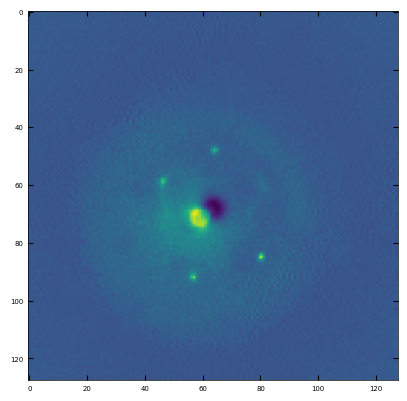

In [116]:
plt.imshow(test)

TypeError: Invalid shape (1, 128, 128) for image data

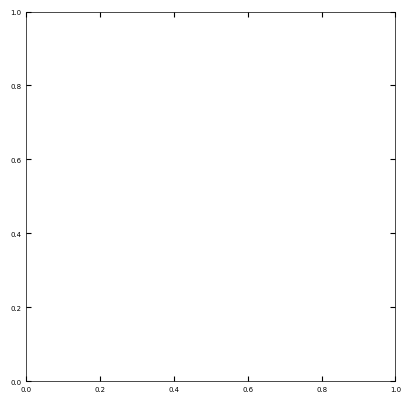

In [118]:
plt.imshow(dset.scaler.inverse_transform(test.reshape(-1,128*128) ).reshape(-1,128,128))

(array([2.1000e+01, 2.0000e+01, 1.1977e+04, 3.9090e+03, 3.5400e+02,
        4.9000e+01, 2.1000e+01, 1.0000e+01, 1.5000e+01, 8.0000e+00]),
 array([-1.06659901, -0.73138329, -0.39616756, -0.06095184,  0.27426388,
         0.60947961,  0.94469533,  1.27991105,  1.61512678,  1.9503425 ,
         2.28555822]),
 <BarContainer object of 10 artists>)

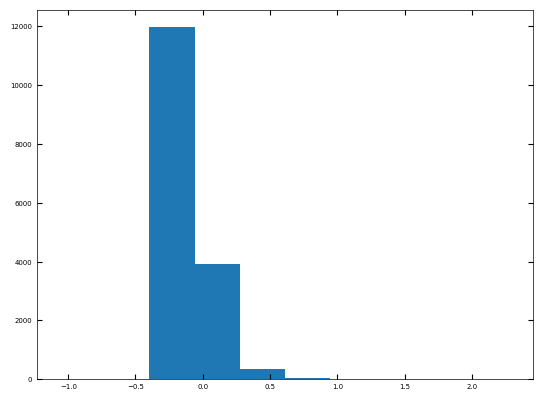

In [112]:
plt.hist(test.flatten())

(array([2.1000e+01, 2.0000e+01, 1.1977e+04, 3.9090e+03, 3.5400e+02,
        4.9000e+01, 2.1000e+01, 1.0000e+01, 1.5000e+01, 8.0000e+00]),
 array([-1.06659901, -0.73138329, -0.39616756, -0.06095184,  0.27426388,
         0.60947961,  0.94469533,  1.27991105,  1.61512678,  1.9503425 ,
         2.28555822]),
 <BarContainer object of 10 artists>)

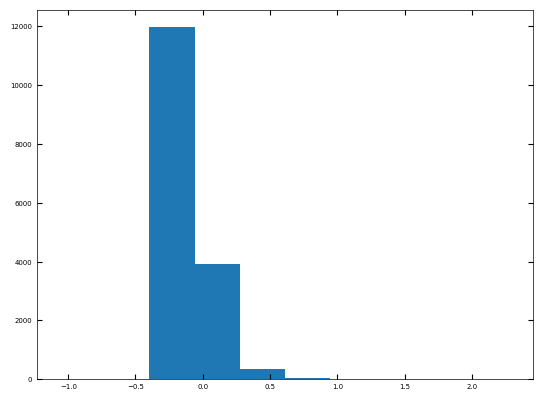

In [109]:
plt.hist(test.flatten())

In [110]:
dset.inverse_scaler([])

StandardScaler()

In [100]:
len(viz.channels)

25

In [70]:
folder_name = "Generator_of_epoch_18"
viz.generator_images( dset.meta, model.generated,
                     scaler=dset.scaler,
    folder_name=folder_name,
    figsize=(7.5,4),
    cbar_number_format="%.02d",
    shape_=(128,128,128,128),
    divider_=False,
    graph_layout=(len(viz.channels),4),
    labelfigs_=True,
    overwrite=False,
    cluster_list=cluster_list
    )

0 AgCu(1)


  0%|          | 0/20 [00:00<?, ?it/s]

100%|██████████| 20/20 [00:39<00:00,  1.98s/it]


1 AgCu(2)


100%|██████████| 20/20 [00:19<00:00,  1.05it/s]


2 AgCu(3)


100%|██████████| 20/20 [00:43<00:00,  2.17s/it]


3 AgCu(5)


100%|██████████| 20/20 [00:41<00:00,  2.07s/it]


4 AgCu(6)


100%|██████████| 20/20 [00:58<00:00,  2.90s/it]


5 AgCu(9)


100%|██████████| 20/20 [00:39<00:00,  2.00s/it]


6 AgCu(10)


100%|██████████| 20/20 [00:30<00:00,  1.55s/it]


7 AgCu(11)


100%|██████████| 20/20 [00:43<00:00,  2.19s/it]


8 AgCu(13)


100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


9 AgCu(14)


100%|██████████| 20/20 [00:29<00:00,  1.49s/it]


10 AgCu(15)


100%|██████████| 20/20 [00:12<00:00,  1.59it/s]


11 AgCu(16)


100%|██████████| 20/20 [00:24<00:00,  1.24s/it]


12 AgCu(17)


100%|██████████| 20/20 [00:21<00:00,  1.08s/it]


13 AgCu(18)


100%|██████████| 20/20 [00:34<00:00,  1.73s/it]


14 AgCu(19)


100%|██████████| 20/20 [00:18<00:00,  1.06it/s]


15 AgCu(20)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


16 AgCu(21)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


17 AgCu(22)


100%|██████████| 20/20 [00:36<00:00,  1.80s/it]


18 AgCu(23)


100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


19 AgCu(24)


100%|██████████| 20/20 [00:12<00:00,  1.60it/s]


20 AgCu(26)


100%|██████████| 20/20 [00:30<00:00,  1.54s/it]


21 AgCu(41)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


22 AgCu(42)


100%|██████████| 20/20 [00:35<00:00,  1.79s/it]


23 AgCu(43)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


24 AgCu(44)


100%|██████████| 20/20 [00:12<00:00,  1.63it/s]


25 AgCu(45)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


26 AgCu(46)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


27 AgCu(48)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


28 AgCu(50)


100%|██████████| 20/20 [00:21<00:00,  1.07s/it]


29 AgCu(53)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


30 AgCu(54)


100%|██████████| 20/20 [00:31<00:00,  1.56s/it]


31 Au30Ag10Co20Ni40(62)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


32 Au30Ag10Co20Ni40(63)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


33 Au30Ag10Co20Ni40(64)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


34 Au30Ag10Co20Ni40(65)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


35 Au30Ag10Co20Ni40(66)


100%|██████████| 20/20 [00:25<00:00,  1.25s/it]


36 Au30Ag10Co20Ni40(67)


100%|██████████| 20/20 [00:06<00:00,  3.17it/s]


37 Au30Ag10Co20Ni40(68)


100%|██████████| 20/20 [00:06<00:00,  3.17it/s]


38 Au30Ag10Co20Ni40(69)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


39 Au30Ag10Co20Ni40(70)


100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


40 Au30Ag10Co20Ni40(71)


100%|██████████| 20/20 [00:38<00:00,  1.91s/it]


41 Au30Cu20Co20Ni30(1)


100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


42 Au30Cu20Co20Ni30(2)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


43 Au30Cu20Co20Ni30(6)


100%|██████████| 20/20 [00:43<00:00,  2.16s/it]


44 Au30Cu20Co20Ni30(7)


100%|██████████| 20/20 [00:24<00:00,  1.22s/it]


45 Au30Cu20Co20Ni30(8)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


46 Au30Cu20Co20Ni30(9)


100%|██████████| 20/20 [00:49<00:00,  2.46s/it]


47 Au30Cu20Co20Ni30(10)


100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


48 Au30Cu20Co20Ni30(11)


100%|██████████| 20/20 [00:52<00:00,  2.62s/it]


49 Au30Cu20Co20Ni30(12)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


50 Au30Cu20Co20Ni30(13)


100%|██████████| 20/20 [00:21<00:00,  1.07s/it]


51 Au30Cu20Co20Ni30(14)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


52 Au30Cu20Co20Ni30(15)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


53 Au30Cu20Co20Ni30(16)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


54 Au30Cu20Co20Ni30(17)


100%|██████████| 20/20 [00:36<00:00,  1.84s/it]


55 Au30Cu20Co20Ni30(18)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


56 Au30Cu20Co20Ni30(19)


100%|██████████| 20/20 [00:40<00:00,  2.04s/it]


57 Au30Cu20Co20Ni30(20)


100%|██████████| 20/20 [00:54<00:00,  2.72s/it]


58 Au30Cu20Co20Ni30(21)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


59 Au30Cu20Co20Ni30(22)


100%|██████████| 20/20 [00:30<00:00,  1.53s/it]


60 Au30Cu20Co20Ni30(23)


100%|██████████| 20/20 [00:31<00:00,  1.56s/it]


61 Au30Cu20Co20Ni30(24)


100%|██████████| 20/20 [00:30<00:00,  1.54s/it]


62 Au30Cu20Co20Ni30(25)


100%|██████████| 20/20 [00:30<00:00,  1.53s/it]


63 Au30Cu20Co20Ni30(27)


100%|██████████| 20/20 [00:37<00:00,  1.85s/it]


64 Au30Cu20Co20Ni30(28)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


65 Au30Cu20Co20Ni30(29)


100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


66 Au30Cu20Co20Ni30(30)


100%|██████████| 20/20 [00:25<00:00,  1.27s/it]


67 Au30Cu20Co20Ni30(31)


100%|██████████| 20/20 [00:37<00:00,  1.87s/it]


68 Au30Cu20Co20Ni30(32)


100%|██████████| 20/20 [00:37<00:00,  1.86s/it]


69 Au30Cu20Co20Ni30(33)


100%|██████████| 20/20 [01:45<00:00,  5.25s/it]


70 Au30Cu20Co20Ni30(34)


100%|██████████| 20/20 [00:37<00:00,  1.88s/it]


71 Au30Cu20Co20Ni30(35)


100%|██████████| 20/20 [00:15<00:00,  1.30it/s]


72 Au30Cu20Co20Ni30(36)


100%|██████████| 20/20 [00:15<00:00,  1.30it/s]


73 Au30Cu20Co20Ni30(37)


100%|██████████| 20/20 [00:15<00:00,  1.29it/s]


74 Au30Cu20Co20Ni30(38)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


75 Au30Cu20Co20Ni30(40)


100%|██████████| 20/20 [00:30<00:00,  1.54s/it]


76 Au30Cu20Co20Ni30(41)


100%|██████████| 20/20 [00:30<00:00,  1.54s/it]


77 Au30Cu20Co20Ni30(42)


100%|██████████| 20/20 [00:31<00:00,  1.56s/it]


78 Au30Cu20Co20Ni30(43)


100%|██████████| 20/20 [00:12<00:00,  1.58it/s]


79 Au30Cu20Co20Ni30(44)


100%|██████████| 20/20 [00:36<00:00,  1.85s/it]


80 Au30Cu20Co20Ni30(45)


100%|██████████| 20/20 [00:40<00:00,  2.01s/it]


81 Au30Cu20Co20Ni30(46)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


82 Au30Cu20Co20Ni30(49)


100%|██████████| 20/20 [00:33<00:00,  1.70s/it]


83 Au30Cu20Co20Ni30(50)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


84 Au30Cu20Co20Ni30(51)


100%|██████████| 20/20 [00:33<00:00,  1.69s/it]


85 Au30Cu20Co20Ni30(53)


100%|██████████| 20/20 [01:25<00:00,  4.26s/it]


86 Au30Cu20Co20Ni30(54)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


87 Au30Cu20Co20Ni30(55)


100%|██████████| 20/20 [00:27<00:00,  1.40s/it]


88 Au30Cu20Co20Ni30(56)


100%|██████████| 20/20 [00:31<00:00,  1.55s/it]


89 Au30Cu20Co20Ni30(57)


100%|██████████| 20/20 [00:37<00:00,  1.86s/it]


90 Au30Cu20Co20Ni30(58)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


91 Au30Cu20Co20Ni30(61)


100%|██████████| 20/20 [00:09<00:00,  2.12it/s]


92 AuCu(3)


100%|██████████| 20/20 [00:30<00:00,  1.54s/it]


93 AuCu(4)


100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


94 AuCu(5)


100%|██████████| 20/20 [00:21<00:00,  1.07s/it]


95 AuCu(6)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


96 AuCu(7)


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


97 AuCu(8)


100%|██████████| 20/20 [00:30<00:00,  1.54s/it]


98 AuCu(9)


100%|██████████| 20/20 [00:34<00:00,  1.72s/it]


99 AuCu(10)


100%|██████████| 20/20 [00:37<00:00,  1.86s/it]


100 AuCu(11)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


101 AuCu(12)


100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


102 AuCu(13)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


103 AuCu(14)


100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


104 AuCu(16)


100%|██████████| 20/20 [00:12<00:00,  1.64it/s]


105 AuCu(18)


100%|██████████| 20/20 [00:18<00:00,  1.07it/s]


106 AuCu(19)


100%|██████████| 20/20 [00:03<00:00,  6.42it/s]


107 AuCu(20)


100%|██████████| 20/20 [00:21<00:00,  1.07s/it]


108 AuCu(21)


100%|██████████| 20/20 [01:21<00:00,  4.06s/it]


109 AuCu(22)


100%|██████████| 20/20 [00:25<00:00,  1.25s/it]


110 AuCu(24)


100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


111 AuCu(25)


100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


112 AuCu(26)


100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


113 AuCu(28)


100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


114 AuCu(31)


100%|██████████| 20/20 [00:12<00:00,  1.63it/s]


115 AuCu(32)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


116 AuCu(33)


100%|██████████| 20/20 [00:18<00:00,  1.07it/s]


117 AuCu(34)


100%|██████████| 20/20 [00:03<00:00,  6.48it/s]


118 AuCu(35)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


119 AuCu(36)


100%|██████████| 20/20 [00:25<00:00,  1.25s/it]


120 AuCu(37)


100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


121 AuCu(38)


100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


122 AuCu(39)


100%|██████████| 20/20 [00:21<00:00,  1.07s/it]


123 AuCu(40)


100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


In [124]:
import collections


In [126]:
h = dset.open_h5()
h.keys()

<KeysViewHDF5 ['processed_data']>

In [130]:
inds0 = dset.meta['particle_inds'][0:2]

In [131]:
particle0 = h['processed_data'][inds0[0]:inds0[1]]

In [137]:
counts = collections.Counter(cluster_list[0].flatten())

In [142]:
0 in counts.keys()

True

In [132]:
collections.Counter(kmeans_pca.labels_[inds0[0]:inds0[1]])

Counter({9: 2581,
         0: 1965,
         18: 3205,
         15: 6412,
         5: 26,
         7: 58,
         16: 1735,
         17: 8,
         10: 351,
         13: 40,
         2: 3})

### Builds a Movie


In [198]:
folder_name = "Generator_of_epoch_6_all_ch"


In [200]:
# Builds a Movie
folder = f"{fig_path}{folder_name}/"
# output_folder = "./movies_unscaled/"
output_folder = "./movies/"


for particle in dset.meta['particle_list']:
    # particle=particle.replace('_',' ')
    print(particle)
    make_movie(f"Generator {particle}", f'{folder}{particle}/', 
               output_folder, "png", 3)

AgCu(1)
AgCu(2)


libpng error: Read Error


AgCu(3)
AgCu(5)
AgCu(6)
AgCu(9)
AgCu(10)
AgCu(11)
AgCu(13)
AgCu(14)
AgCu(15)
AgCu(16)
AgCu(17)
AgCu(18)
AgCu(19)
AgCu(20)
AgCu(21)
AgCu(22)
AgCu(23)
AgCu(24)
AgCu(26)
AgCu(41)
AgCu(42)
AgCu(43)
AgCu(44)
AgCu(45)
AgCu(46)
AgCu(48)
AgCu(50)
AgCu(53)
AgCu(54)
Au30Ag10Co20Ni40(62)
Au30Ag10Co20Ni40(63)
Au30Ag10Co20Ni40(64)
Au30Ag10Co20Ni40(65)
Au30Ag10Co20Ni40(66)
Au30Ag10Co20Ni40(67)
Au30Ag10Co20Ni40(68)
Au30Ag10Co20Ni40(69)
Au30Ag10Co20Ni40(70)
Au30Ag10Co20Ni40(71)
Au30Cu20Co20Ni30(1)
Au30Cu20Co20Ni30(2)
Au30Cu20Co20Ni30(6)
Au30Cu20Co20Ni30(7)
Au30Cu20Co20Ni30(8)
Au30Cu20Co20Ni30(9)
Au30Cu20Co20Ni30(10)
Au30Cu20Co20Ni30(11)
Au30Cu20Co20Ni30(12)
Au30Cu20Co20Ni30(13)
Au30Cu20Co20Ni30(14)


IndexError: list index out of range

### Generate from specified embedding range

In [ ]:
g_folder = str(channels).replace(', ','_')[1:-1]

In [ ]:
g_folder

'0_1_4_7_8_10_14_17_19_22_25_28_31'

In [ ]:
fig_path

'./../../Northwestern/auagconi_aucuconi/2021_07_10_stela_80kV/Au30Ag10Co20Ni40_Figures/'

In [ ]:
# Builds a Movie
folder = f"{fig_path}/generator_{g_folder}"
output_folder = "./movies/"

In [ ]:
'generator_[1, 3, 8, 10, 11, 13, 15, 17, 22, 26]'

In [ ]:
# Builds a Movie
folder = f"{fig_path}/generator_{g_folder}"
output_folder = "./movies/"

# function to make the movie
make_movie("Domain Generator", folder, output_folder, "png", 3)

## Vortex Domains

### Loads the Dataset


In [ ]:
# loads the dataset
# this object will also compute the log of the dataset
# this is available as self.log_data
vortex = STEM_Dataset(
    data_path=f"{data_path}/SED_256x256x12_30x30_alpha3_NBD_spot0p5nm_CL12cm_vortex.hspy"
)

NameError: name 'STEM_Dataset' is not defined

### Visualizes the Raw Data

./../../../Figures/2023_STEM_AE/STEM_raw_and_virtual_vortex_domains.png
./../../../Figures/2023_STEM_AE/STEM_raw_and_virtual_vortex_domains.svg


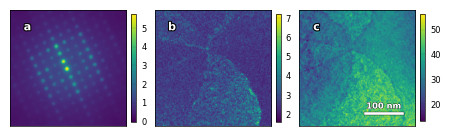

In [ ]:
bright_field_ = (150, 162, 152, 165)
dark_field_ = (106, 123, 110, 125)
filename = "STEM_raw_and_virtual_vortex_domains"
viz.scalebar_ = {"width": 291, "scale length": 100, "units": "nm"}
viz.STEM_raw_and_virtual(
    vortex,
    bright_field_=bright_field_,
    dark_field_=dark_field_,
    scalebar_=True,
    filename=filename,
    shape_=vortex.data.shape,
)

### Builds the Neural Network Model


In [ ]:
encoder_step_size = [256, 256]
pooling_list = [4, 4, 2]
decoder_step_size = [8, 8]
upsampling_list = [2, 4, 4]
embedding_size = 32
conv_size = 128

# set device to load model
device = "cpu"
if torch.cuda.is_available():
    device = "cuda:1"

model = ConvAutoencoder(
    encoder_step_size=encoder_step_size,
    pooling_list=pooling_list,
    decoder_step_size=decoder_step_size,
    upsampling_list=upsampling_list,
    embedding_size=embedding_size,
    conv_size=conv_size,
    device=device,
    learning_rate=3e-5,
)


### Trains or Loads Pretrained Weights


In [ ]:
# set retrain parameter
train = False

if train:
    model.Train(
        vortex.log_data,
        coef_1=1e-5,
        epochs=225,
        with_scheduler=False,
        folder_path="vortex_domains_Weights",
        batch_size=256,
    )

    model.Train(
        vortex.log_data,
        max_learning_rate=5e-5,
        coef_1=5e-4,
        epochs=286,
        epoch_=224,
        with_scheduler=True,
        folder_path="vortex_domains_Weights",
        batch_size=256,
    )
else:
    model.load_weights(
        f"{save_path}/4.5_log_epoch_0285_L1loss_0.0001__lr_0.00003_trainloss_0.2279.pkl"
    )

### Computes the Embeddings


In [ ]:
embedding = model.get_embedding(vortex.log_data)


100%|██████████| 2048/2048 [04:09<00:00,  8.19it/s]


### Visualizes the Embeddings


./../../../Figures/2023_STEM_AE/vortex_domains_embedding_maps.png
./../../../Figures/2023_STEM_AE/vortex_domains_embedding_maps.svg


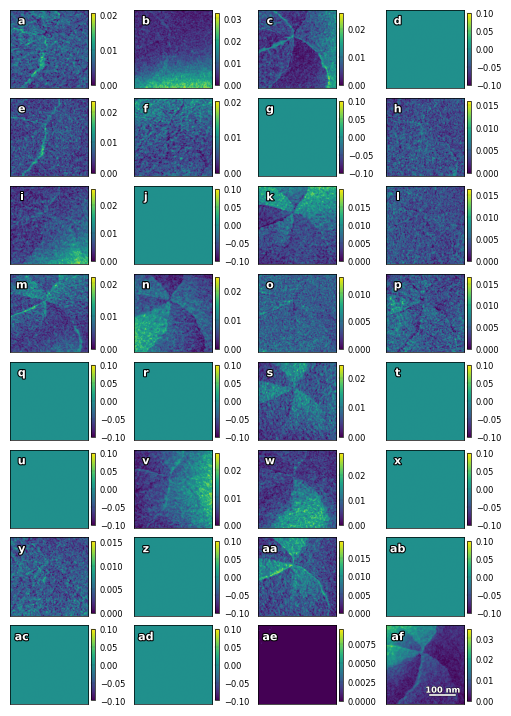

In [ ]:
viz.model = model
viz.channels = None
viz.scalebar_ = {"width": 291, "scale length": 100, "units": "nm"}
viz.embeddings(
    mod=4,
    scalebar_=viz.scalebar_,
    figsize=(5, 8),
    name="vortex_domains",
    shape_=vortex.data.shape,
)

### Generates Data from the Latent Space

In [ ]:
model.embedding = embedding
viz.model = model
viz.channels = [13, 31]
ranges = [[0, 0.0225], [0, 0.03]]
folder_name = "Generator_of_Figure_4_vortex_domains"

viz.generator_images(
    ranges=ranges,
    folder_name=folder_name,
    figsize=(5, 1.25),
    cbar_number_format="%d",
    shape_=vortex.data.shape,
    divider_=False,
)

  0%|          | 0/200 [00:00<?, ?it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0000_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0000_maps.svg


  0%|          | 1/200 [00:00<03:18,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0001_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0001_maps.svg


  1%|          | 2/200 [00:01<03:16,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0002_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0002_maps.svg


  2%|▏         | 3/200 [00:02<03:15,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0003_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0003_maps.svg


  2%|▏         | 4/200 [00:03<03:15,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0004_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0004_maps.svg


  2%|▎         | 5/200 [00:04<03:13,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0005_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0005_maps.svg


  3%|▎         | 6/200 [00:05<03:12,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0006_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0006_maps.svg


  4%|▎         | 7/200 [00:06<03:11,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0007_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0007_maps.svg


  4%|▍         | 8/200 [00:07<03:10,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0008_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0008_maps.svg


  4%|▍         | 9/200 [00:08<03:09,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0009_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0009_maps.svg


  5%|▌         | 10/200 [00:09<03:08,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0010_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0010_maps.svg


  6%|▌         | 11/200 [00:10<03:07,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0011_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0011_maps.svg


  6%|▌         | 12/200 [00:11<03:06,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0012_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0012_maps.svg


  6%|▋         | 13/200 [00:12<03:05,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0013_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0013_maps.svg


  7%|▋         | 14/200 [00:13<03:04,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0014_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0014_maps.svg


  8%|▊         | 15/200 [00:14<03:03,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0015_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0015_maps.svg


  8%|▊         | 16/200 [00:15<03:02,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0016_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0016_maps.svg


  8%|▊         | 17/200 [00:16<03:01,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0017_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0017_maps.svg


  9%|▉         | 18/200 [00:17<03:00,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0018_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0018_maps.svg


 10%|▉         | 19/200 [00:18<02:59,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0019_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0019_maps.svg


 10%|█         | 20/200 [00:21<04:45,  1.59s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0020_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0020_maps.svg


 10%|█         | 21/200 [00:22<04:12,  1.41s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0021_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0021_maps.svg


 11%|█         | 22/200 [00:23<03:49,  1.29s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0022_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0022_maps.svg


 12%|█▏        | 23/200 [00:24<03:32,  1.20s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0023_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0023_maps.svg


 12%|█▏        | 24/200 [00:25<03:20,  1.14s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0024_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0024_maps.svg


 12%|█▎        | 25/200 [00:26<03:12,  1.10s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0025_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0025_maps.svg


 13%|█▎        | 26/200 [00:27<03:05,  1.07s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0026_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0026_maps.svg


 14%|█▎        | 27/200 [00:28<03:01,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0027_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0027_maps.svg


 14%|█▍        | 28/200 [00:29<02:57,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0028_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0028_maps.svg


 14%|█▍        | 29/200 [00:30<02:55,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0029_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0029_maps.svg


 15%|█▌        | 30/200 [00:31<02:52,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0030_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0030_maps.svg


 16%|█▌        | 31/200 [00:32<02:51,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0031_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0031_maps.svg


 16%|█▌        | 32/200 [00:33<02:49,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0032_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0032_maps.svg


 16%|█▋        | 33/200 [00:35<03:02,  1.09s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0033_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0033_maps.svg


 17%|█▋        | 34/200 [00:36<02:56,  1.06s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0034_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0034_maps.svg


 18%|█▊        | 35/200 [00:37<02:52,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0035_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0035_maps.svg


 18%|█▊        | 36/200 [00:38<02:49,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0036_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0036_maps.svg


 18%|█▊        | 37/200 [00:39<02:46,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0037_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0037_maps.svg


 19%|█▉        | 38/200 [00:40<02:44,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0038_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0038_maps.svg


 20%|█▉        | 39/200 [00:41<02:42,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0039_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0039_maps.svg


 20%|██        | 40/200 [00:42<02:41,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0040_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0040_maps.svg


 20%|██        | 41/200 [00:43<02:39,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0041_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0041_maps.svg


 21%|██        | 42/200 [00:44<02:38,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0042_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0042_maps.svg


 22%|██▏       | 43/200 [00:45<02:37,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0043_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0043_maps.svg


 22%|██▏       | 44/200 [00:46<02:35,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0044_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0044_maps.svg


 22%|██▎       | 45/200 [00:47<02:34,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0045_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0045_maps.svg


 23%|██▎       | 46/200 [00:48<02:33,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0046_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0046_maps.svg


 24%|██▎       | 47/200 [00:49<02:32,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0047_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0047_maps.svg


 24%|██▍       | 48/200 [00:50<02:31,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0048_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0048_maps.svg


 24%|██▍       | 49/200 [00:51<02:30,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0049_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0049_maps.svg


 25%|██▌       | 50/200 [00:52<02:45,  1.10s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0050_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0050_maps.svg


 26%|██▌       | 51/200 [00:53<02:39,  1.07s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0051_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0051_maps.svg


 26%|██▌       | 52/200 [00:54<02:34,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0052_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0052_maps.svg


 26%|██▋       | 53/200 [00:55<02:31,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0053_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0053_maps.svg


 27%|██▋       | 54/200 [00:56<02:29,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0054_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0054_maps.svg


 28%|██▊       | 55/200 [00:57<02:27,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0055_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0055_maps.svg


 28%|██▊       | 56/200 [00:58<02:25,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0056_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0056_maps.svg


 28%|██▊       | 57/200 [00:59<02:23,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0057_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0057_maps.svg


 29%|██▉       | 58/200 [01:00<02:22,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0058_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0058_maps.svg


 30%|██▉       | 59/200 [01:01<02:21,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0059_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0059_maps.svg


 30%|███       | 60/200 [01:02<02:19,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0060_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0060_maps.svg


 30%|███       | 61/200 [01:03<02:18,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0061_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0061_maps.svg


 31%|███       | 62/200 [01:04<02:17,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0062_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0062_maps.svg


 32%|███▏      | 63/200 [01:05<02:16,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0063_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0063_maps.svg


 32%|███▏      | 64/200 [01:06<02:15,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0064_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0064_maps.svg


 32%|███▎      | 65/200 [01:07<02:14,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0065_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0065_maps.svg


 33%|███▎      | 66/200 [01:08<02:13,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0066_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0066_maps.svg


 34%|███▎      | 67/200 [01:09<02:12,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0067_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0067_maps.svg


 34%|███▍      | 68/200 [01:10<02:11,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0068_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0068_maps.svg


 34%|███▍      | 69/200 [01:11<02:10,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0069_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0069_maps.svg


 35%|███▌      | 70/200 [01:12<02:09,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0070_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0070_maps.svg


 36%|███▌      | 71/200 [01:13<02:24,  1.12s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0071_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0071_maps.svg


 36%|███▌      | 72/200 [01:14<02:18,  1.08s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0072_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0072_maps.svg


 36%|███▋      | 73/200 [01:15<02:14,  1.06s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0073_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0073_maps.svg


 37%|███▋      | 74/200 [01:16<02:10,  1.04s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0074_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0074_maps.svg


 38%|███▊      | 75/200 [01:17<02:08,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0075_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0075_maps.svg


 38%|███▊      | 76/200 [01:18<02:05,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0076_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0076_maps.svg


 38%|███▊      | 77/200 [01:19<02:04,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0077_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0077_maps.svg


 39%|███▉      | 78/200 [01:20<02:02,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0078_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0078_maps.svg


 40%|███▉      | 79/200 [01:21<02:01,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0079_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0079_maps.svg


 40%|████      | 80/200 [01:22<02:00,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0080_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0080_maps.svg


 40%|████      | 81/200 [01:23<01:58,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0081_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0081_maps.svg


 41%|████      | 82/200 [01:24<01:57,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0082_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0082_maps.svg


 42%|████▏     | 83/200 [01:25<01:56,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0083_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0083_maps.svg


 42%|████▏     | 84/200 [01:26<01:55,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0084_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0084_maps.svg


 42%|████▎     | 85/200 [01:27<01:54,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0085_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0085_maps.svg


 43%|████▎     | 86/200 [01:28<01:53,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0086_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0086_maps.svg


 44%|████▎     | 87/200 [01:29<01:52,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0087_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0087_maps.svg


 44%|████▍     | 88/200 [01:30<01:51,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0088_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0088_maps.svg


 44%|████▍     | 89/200 [01:31<01:50,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0089_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0089_maps.svg


 45%|████▌     | 90/200 [01:32<01:49,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0090_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0090_maps.svg


 46%|████▌     | 91/200 [01:33<01:48,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0091_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0091_maps.svg


 46%|████▌     | 92/200 [01:34<01:47,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0092_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0092_maps.svg


 46%|████▋     | 93/200 [01:35<01:46,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0093_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0093_maps.svg


 47%|████▋     | 94/200 [01:36<01:45,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0094_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0094_maps.svg


 48%|████▊     | 95/200 [01:37<01:44,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0095_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0095_maps.svg


 48%|████▊     | 96/200 [01:38<01:43,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0096_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0096_maps.svg


 48%|████▊     | 97/200 [01:40<01:58,  1.15s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0097_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0097_maps.svg


 49%|████▉     | 98/200 [01:41<01:52,  1.10s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0098_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0098_maps.svg


 50%|████▉     | 99/200 [01:42<01:47,  1.07s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0099_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0099_maps.svg


 50%|█████     | 100/200 [01:43<01:44,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0100_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0100_maps.svg


 50%|█████     | 101/200 [01:44<01:42,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0101_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0101_maps.svg


 51%|█████     | 102/200 [01:45<01:39,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0102_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0102_maps.svg


 52%|█████▏    | 103/200 [01:46<01:38,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0103_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0103_maps.svg


 52%|█████▏    | 104/200 [01:47<01:36,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0104_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0104_maps.svg


 52%|█████▎    | 105/200 [01:48<01:35,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0105_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0105_maps.svg


 53%|█████▎    | 106/200 [01:49<01:34,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0106_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0106_maps.svg


 54%|█████▎    | 107/200 [01:50<01:32,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0107_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0107_maps.svg


 54%|█████▍    | 108/200 [01:51<01:31,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0108_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0108_maps.svg


 55%|█████▍    | 109/200 [01:52<01:30,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0109_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0109_maps.svg


 55%|█████▌    | 110/200 [01:53<01:29,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0110_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0110_maps.svg


 56%|█████▌    | 111/200 [01:54<01:28,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0111_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0111_maps.svg


 56%|█████▌    | 112/200 [01:55<01:27,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0112_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0112_maps.svg


 56%|█████▋    | 113/200 [01:56<01:26,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0113_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0113_maps.svg


 57%|█████▋    | 114/200 [01:57<01:25,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0114_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0114_maps.svg


 57%|█████▊    | 115/200 [01:58<01:24,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0115_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0115_maps.svg


 58%|█████▊    | 116/200 [01:59<01:23,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0116_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0116_maps.svg


 58%|█████▊    | 117/200 [02:00<01:22,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0117_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0117_maps.svg


 59%|█████▉    | 118/200 [02:01<01:21,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0118_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0118_maps.svg


 60%|█████▉    | 119/200 [02:02<01:20,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0119_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0119_maps.svg


 60%|██████    | 120/200 [02:03<01:19,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0120_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0120_maps.svg


 60%|██████    | 121/200 [02:03<01:18,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0121_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0121_maps.svg


 61%|██████    | 122/200 [02:04<01:17,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0122_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0122_maps.svg


 62%|██████▏   | 123/200 [02:05<01:16,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0123_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0123_maps.svg


 62%|██████▏   | 124/200 [02:06<01:15,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0124_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0124_maps.svg


 62%|██████▎   | 125/200 [02:07<01:14,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0125_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0125_maps.svg


 63%|██████▎   | 126/200 [02:08<01:13,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0126_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0126_maps.svg


 64%|██████▎   | 127/200 [02:09<01:12,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0127_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0127_maps.svg


 64%|██████▍   | 128/200 [02:10<01:11,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0128_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0128_maps.svg


 64%|██████▍   | 129/200 [02:11<01:10,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0129_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0129_maps.svg


 65%|██████▌   | 130/200 [02:13<01:22,  1.18s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0130_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0130_maps.svg


 66%|██████▌   | 131/200 [02:14<01:17,  1.13s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0131_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0131_maps.svg


 66%|██████▌   | 132/200 [02:15<01:13,  1.09s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0132_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0132_maps.svg


 66%|██████▋   | 133/200 [02:16<01:10,  1.06s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0133_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0133_maps.svg


 67%|██████▋   | 134/200 [02:17<01:08,  1.04s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0134_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0134_maps.svg


 68%|██████▊   | 135/200 [02:18<01:06,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0135_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0135_maps.svg


 68%|██████▊   | 136/200 [02:19<01:04,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0136_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0136_maps.svg


 68%|██████▊   | 137/200 [02:20<01:03,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0137_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0137_maps.svg


 69%|██████▉   | 138/200 [02:21<01:02,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0138_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0138_maps.svg


 70%|██████▉   | 139/200 [02:22<01:01,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0139_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0139_maps.svg


 70%|███████   | 140/200 [02:23<00:59,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0140_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0140_maps.svg


 70%|███████   | 141/200 [02:24<00:58,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0141_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0141_maps.svg


 71%|███████   | 142/200 [02:25<00:57,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0142_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0142_maps.svg


 72%|███████▏  | 143/200 [02:26<00:56,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0143_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0143_maps.svg


 72%|███████▏  | 144/200 [02:27<00:55,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0144_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0144_maps.svg


 72%|███████▎  | 145/200 [02:28<00:54,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0145_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0145_maps.svg


 73%|███████▎  | 146/200 [02:29<00:53,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0146_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0146_maps.svg


 74%|███████▎  | 147/200 [02:30<00:52,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0147_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0147_maps.svg


 74%|███████▍  | 148/200 [02:31<00:51,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0148_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0148_maps.svg


 74%|███████▍  | 149/200 [02:32<00:50,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0149_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0149_maps.svg


 75%|███████▌  | 150/200 [02:33<00:49,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0150_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0150_maps.svg


 76%|███████▌  | 151/200 [02:34<00:48,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0151_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0151_maps.svg


 76%|███████▌  | 152/200 [02:35<00:47,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0152_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0152_maps.svg


 76%|███████▋  | 153/200 [02:36<00:46,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0153_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0153_maps.svg


 77%|███████▋  | 154/200 [02:37<00:45,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0154_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0154_maps.svg


 78%|███████▊  | 155/200 [02:38<00:44,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0155_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0155_maps.svg


 78%|███████▊  | 156/200 [02:39<00:43,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0156_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0156_maps.svg


 78%|███████▊  | 157/200 [02:40<00:42,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0157_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0157_maps.svg


 79%|███████▉  | 158/200 [02:41<00:41,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0158_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0158_maps.svg


 80%|███████▉  | 159/200 [02:42<00:40,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0159_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0159_maps.svg


 80%|████████  | 160/200 [02:43<00:39,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0160_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0160_maps.svg


 80%|████████  | 161/200 [02:44<00:38,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0161_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0161_maps.svg


 81%|████████  | 162/200 [02:45<00:37,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0162_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0162_maps.svg


 82%|████████▏ | 163/200 [02:46<00:36,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0163_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0163_maps.svg


 82%|████████▏ | 164/200 [02:47<00:35,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0164_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0164_maps.svg


 82%|████████▎ | 165/200 [02:48<00:34,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0165_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0165_maps.svg


 83%|████████▎ | 166/200 [02:49<00:33,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0166_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0166_maps.svg


 84%|████████▎ | 167/200 [02:50<00:32,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0167_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0167_maps.svg


 84%|████████▍ | 168/200 [02:51<00:31,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0168_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0168_maps.svg


 84%|████████▍ | 169/200 [02:52<00:30,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0169_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0169_maps.svg


 85%|████████▌ | 170/200 [02:54<00:36,  1.23s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0170_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0170_maps.svg


 86%|████████▌ | 171/200 [02:55<00:33,  1.16s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0171_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0171_maps.svg


 86%|████████▌ | 172/200 [02:56<00:31,  1.11s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0172_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0172_maps.svg


 86%|████████▋ | 173/200 [02:57<00:29,  1.07s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0173_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0173_maps.svg


 87%|████████▋ | 174/200 [02:58<00:27,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0174_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0174_maps.svg


 88%|████████▊ | 175/200 [02:59<00:25,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0175_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0175_maps.svg


 88%|████████▊ | 176/200 [03:00<00:24,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0176_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0176_maps.svg


 88%|████████▊ | 177/200 [03:01<00:23,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0177_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0177_maps.svg


 89%|████████▉ | 178/200 [03:02<00:22,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0178_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0178_maps.svg


 90%|████████▉ | 179/200 [03:03<00:21,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0179_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0179_maps.svg


 90%|█████████ | 180/200 [03:04<00:20,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0180_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0180_maps.svg


 90%|█████████ | 181/200 [03:05<00:18,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0181_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0181_maps.svg


 91%|█████████ | 182/200 [03:06<00:17,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0182_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0182_maps.svg


 92%|█████████▏| 183/200 [03:07<00:16,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0183_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0183_maps.svg


 92%|█████████▏| 184/200 [03:08<00:15,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0184_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0184_maps.svg


 92%|█████████▎| 185/200 [03:09<00:14,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0185_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0185_maps.svg


 93%|█████████▎| 186/200 [03:10<00:13,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0186_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0186_maps.svg


 94%|█████████▎| 187/200 [03:11<00:12,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0187_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0187_maps.svg


 94%|█████████▍| 188/200 [03:12<00:11,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0188_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0188_maps.svg


 94%|█████████▍| 189/200 [03:13<00:10,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0189_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0189_maps.svg


 95%|█████████▌| 190/200 [03:14<00:09,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0190_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0190_maps.svg


 96%|█████████▌| 191/200 [03:15<00:08,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0191_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0191_maps.svg


 96%|█████████▌| 192/200 [03:16<00:07,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0192_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0192_maps.svg


 96%|█████████▋| 193/200 [03:16<00:06,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0193_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0193_maps.svg


 97%|█████████▋| 194/200 [03:17<00:05,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0194_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0194_maps.svg


 98%|█████████▊| 195/200 [03:18<00:04,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0195_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0195_maps.svg


 98%|█████████▊| 196/200 [03:19<00:03,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0196_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0196_maps.svg


 98%|█████████▊| 197/200 [03:20<00:02,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0197_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0197_maps.svg


 99%|█████████▉| 198/200 [03:21<00:01,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0198_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0198_maps.svg


100%|█████████▉| 199/200 [03:22<00:00,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0199_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_vortex_domains/0199_maps.svg


100%|██████████| 200/200 [03:23<00:00,  1.02s/it]


### Builds the Movie

In [ ]:
# Builds a Movie
folder = f"{fig_path}/generator_images_Generator_of_Figure_4_vortex_domains/"
output_folder = "./movies/"

# function to make the movie
make_movie("Vortex Domains Generator", folder, output_folder, "png", 3)

## Vortex Domain Walls


### Builds the Neural Network Model


In [ ]:
encoder_step_size = [256, 256]
pooling_list = [4, 4, 2]
decoder_step_size = [8, 8]
upsampling_list = [2, 4, 4]
embedding_size = 32
conv_size = 128

# set device to load model
device = "cpu"
if torch.cuda.is_available():
    device = "cuda:1"

model = ConvAutoencoder(
    encoder_step_size=encoder_step_size,
    pooling_list=pooling_list,
    decoder_step_size=decoder_step_size,
    upsampling_list=upsampling_list,
    embedding_size=embedding_size,
    conv_size=conv_size,
    device=device,
    learning_rate=3e-5,
)


### Trains or Loads Pretrained Weights


In this model we have additional custom regularization to the embedding to help with disentangling the vortices from the walls.

1. We have an l1 activity regularization:

$$ \sum\_{i=1}^{n} |a_i| $$

2. We have a contrastive regularization:

$$ L = \frac{\lambda*1}{2N} \sum\limits*{i=1}^{N} \left[\left(\sum\limits_{j=1, j\neq i}^{N} \frac{latent_i \cdot latent_j}{\left\lVert latent_i \right\rVert \left\lVert latent_j \right\rVert}\right] - 1\right)$$

3. Divergence regularization:

$$L = \frac{1}{B} \sum\limits_{i=1}^{B} \left(\frac{\lambda_2}{2} \sum\limits_{j=1}^{n} \sum\limits_{k=j+1}^{n} \left| latent_{i,j} - latent_{i,k} \right|\right)$$


In [ ]:
# set retrain parameter
train = False

if train:
    model.Train(
        vortex.log_data,
        coef_0=5e-3,
        coef_1=5e-5,
        coef_2=2e-4,
        epochs=18,
        with_scheduler=False,
        folder_path="Vortex_walls_Weights",
        batch_size=256,
    )
else:
    model.load_weights(
        f"{save_path}/11.1_log_epoch_0017_L1loss_0.00181_l1coef_0.0050_lr_0.00009_contrasPara_0.000050_contrasLoss_0.00020_maxiPara_0.00070_maxiLoss_0.0019_trainloss_0.2289.pkl"
    )

### Computes the Embeddings


In [ ]:
embedding = model.get_embedding(vortex.log_data)


100%|██████████| 2048/2048 [04:09<00:00,  8.20it/s]


### Visualizes the Embeddings


In [ ]:
viz.channels = None
viz.model = model
viz.scalebar_ = {"width": 291, "scale length": 100, "units": "nm"}
viz.embeddings(
    mod=4,
    scalebar_=viz.scalebar_,
    figsize=(5, 8),
    name="Vortex_walls",
    shape_=vortex.data.shape,
)

NameError: name 'viz' is not defined

### Generates Data from the Latent Space

In [ ]:
model.embedding = embedding
viz.model = model
viz.channels = [0, 2]
ranges = [[0, 0.025], [0, 0.04]]
folder_name = "Generator_of_Figure_4_e_f_vortex_walls"

viz.generator_images(
    ranges=ranges,
    folder_name=folder_name,
    figsize=(5, 1.25),
    cbar_number_format="%d",
    shape_=vortex.data.shape,
    divider_=False,
)

  0%|          | 0/200 [00:00<?, ?it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0000_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0000_maps.svg


  0%|          | 1/200 [00:00<03:14,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0001_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0001_maps.svg


  1%|          | 2/200 [00:01<03:11,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0002_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0002_maps.svg


  2%|▏         | 3/200 [00:02<03:09,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0003_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0003_maps.svg


  2%|▏         | 4/200 [00:03<03:07,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0004_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0004_maps.svg


  2%|▎         | 5/200 [00:04<03:05,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0005_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0005_maps.svg


  3%|▎         | 6/200 [00:05<03:04,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0006_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0006_maps.svg


  4%|▎         | 7/200 [00:06<03:03,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0007_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0007_maps.svg


  4%|▍         | 8/200 [00:07<03:02,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0008_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0008_maps.svg


  4%|▍         | 9/200 [00:08<03:01,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0009_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0009_maps.svg


  5%|▌         | 10/200 [00:11<05:01,  1.59s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0010_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0010_maps.svg


  6%|▌         | 11/200 [00:12<04:23,  1.40s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0011_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0011_maps.svg


  6%|▌         | 12/200 [00:13<03:57,  1.27s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0012_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0012_maps.svg


  6%|▋         | 13/200 [00:14<03:39,  1.17s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0013_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0013_maps.svg


  7%|▋         | 14/200 [00:15<03:26,  1.11s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0014_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0014_maps.svg


  8%|▊         | 15/200 [00:16<03:16,  1.06s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0015_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0015_maps.svg


  8%|▊         | 16/200 [00:17<03:10,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0016_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0016_maps.svg


  8%|▊         | 17/200 [00:18<03:05,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0017_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0017_maps.svg


  9%|▉         | 18/200 [00:19<03:01,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0018_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0018_maps.svg


 10%|▉         | 19/200 [00:20<02:58,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0019_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0019_maps.svg


 10%|█         | 20/200 [00:21<02:56,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0020_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0020_maps.svg


 10%|█         | 21/200 [00:22<02:54,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0021_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0021_maps.svg


 11%|█         | 22/200 [00:23<03:05,  1.04s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0022_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0022_maps.svg


 12%|█▏        | 23/200 [00:24<03:00,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0023_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0023_maps.svg


 12%|█▏        | 24/200 [00:25<02:56,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0024_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0024_maps.svg


 12%|█▎        | 25/200 [00:26<02:52,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0025_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0025_maps.svg


 13%|█▎        | 26/200 [00:27<02:50,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0026_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0026_maps.svg


 14%|█▎        | 27/200 [00:28<02:48,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0027_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0027_maps.svg


 14%|█▍        | 28/200 [00:29<02:46,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0028_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0028_maps.svg


 14%|█▍        | 29/200 [00:30<02:45,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0029_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0029_maps.svg


 15%|█▌        | 30/200 [00:31<02:43,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0030_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0030_maps.svg


 16%|█▌        | 31/200 [00:32<02:42,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0031_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0031_maps.svg


 16%|█▌        | 32/200 [00:33<02:41,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0032_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0032_maps.svg


 16%|█▋        | 33/200 [00:33<02:40,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0033_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0033_maps.svg


 17%|█▋        | 34/200 [00:34<02:39,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0034_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0034_maps.svg


 18%|█▊        | 35/200 [00:35<02:38,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0035_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0035_maps.svg


 18%|█▊        | 36/200 [00:37<02:52,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0036_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0036_maps.svg


 18%|█▊        | 37/200 [00:38<02:47,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0037_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0037_maps.svg


 19%|█▉        | 38/200 [00:39<02:42,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0038_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0038_maps.svg


 20%|█▉        | 39/200 [00:40<02:39,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0039_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0039_maps.svg


 20%|██        | 40/200 [00:40<02:37,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0040_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0040_maps.svg


 20%|██        | 41/200 [00:41<02:35,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0041_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0041_maps.svg


 21%|██        | 42/200 [00:42<02:33,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0042_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0042_maps.svg


 22%|██▏       | 43/200 [00:43<02:32,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0043_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0043_maps.svg


 22%|██▏       | 44/200 [00:44<02:30,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0044_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0044_maps.svg


 22%|██▎       | 45/200 [00:45<02:29,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0045_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0045_maps.svg


 23%|██▎       | 46/200 [00:46<02:28,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0046_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0046_maps.svg


 24%|██▎       | 47/200 [00:47<02:27,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0047_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0047_maps.svg


 24%|██▍       | 48/200 [00:48<02:26,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0048_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0048_maps.svg


 24%|██▍       | 49/200 [00:49<02:25,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0049_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0049_maps.svg


 25%|██▌       | 50/200 [00:50<02:24,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0050_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0050_maps.svg


 26%|██▌       | 51/200 [00:51<02:23,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0051_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0051_maps.svg


 26%|██▌       | 52/200 [00:52<02:21,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0052_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0052_maps.svg


 26%|██▋       | 53/200 [00:53<02:20,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0053_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0053_maps.svg


 27%|██▋       | 54/200 [00:54<02:36,  1.07s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0054_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0054_maps.svg


 28%|██▊       | 55/200 [00:55<02:30,  1.04s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0055_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0055_maps.svg


 28%|██▊       | 56/200 [00:56<02:26,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0056_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0056_maps.svg


 28%|██▊       | 57/200 [00:57<02:22,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0057_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0057_maps.svg


 29%|██▉       | 58/200 [00:58<02:20,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0058_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0058_maps.svg


 30%|██▉       | 59/200 [00:59<02:17,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0059_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0059_maps.svg


 30%|███       | 60/200 [01:00<02:16,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0060_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0060_maps.svg


 30%|███       | 61/200 [01:01<02:14,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0061_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0061_maps.svg


 31%|███       | 62/200 [01:02<02:13,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0062_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0062_maps.svg


 32%|███▏      | 63/200 [01:03<02:12,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0063_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0063_maps.svg


 32%|███▏      | 64/200 [01:04<02:11,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0064_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0064_maps.svg


 32%|███▎      | 65/200 [01:05<02:09,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0065_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0065_maps.svg


 33%|███▎      | 66/200 [01:06<02:08,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0066_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0066_maps.svg


 34%|███▎      | 67/200 [01:07<02:07,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0067_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0067_maps.svg


 34%|███▍      | 68/200 [01:08<02:06,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0068_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0068_maps.svg


 34%|███▍      | 69/200 [01:09<02:05,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0069_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0069_maps.svg


 35%|███▌      | 70/200 [01:10<02:04,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0070_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0070_maps.svg


 36%|███▌      | 71/200 [01:11<02:03,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0071_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0071_maps.svg


 36%|███▌      | 72/200 [01:12<02:03,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0072_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0072_maps.svg


 36%|███▋      | 73/200 [01:13<02:01,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0073_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0073_maps.svg


 37%|███▋      | 74/200 [01:13<02:01,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0074_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0074_maps.svg


 38%|███▊      | 75/200 [01:14<02:00,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0075_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0075_maps.svg


 38%|███▊      | 76/200 [01:16<02:16,  1.10s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0076_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0076_maps.svg


 38%|███▊      | 77/200 [01:17<02:10,  1.06s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0077_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0077_maps.svg


 39%|███▉      | 78/200 [01:18<02:05,  1.03s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0078_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0078_maps.svg


 40%|███▉      | 79/200 [01:19<02:01,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0079_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0079_maps.svg


 40%|████      | 80/200 [01:20<01:59,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0080_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0080_maps.svg


 40%|████      | 81/200 [01:21<01:56,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0081_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0081_maps.svg


 41%|████      | 82/200 [01:22<01:55,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0082_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0082_maps.svg


 42%|████▏     | 83/200 [01:23<01:53,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0083_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0083_maps.svg


 42%|████▏     | 84/200 [01:24<01:52,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0084_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0084_maps.svg


 42%|████▎     | 85/200 [01:25<01:50,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0085_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0085_maps.svg


 43%|████▎     | 86/200 [01:25<01:49,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0086_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0086_maps.svg


 44%|████▎     | 87/200 [01:26<01:48,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0087_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0087_maps.svg


 44%|████▍     | 88/200 [01:27<01:47,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0088_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0088_maps.svg


 44%|████▍     | 89/200 [01:28<01:46,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0089_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0089_maps.svg


 45%|████▌     | 90/200 [01:29<01:45,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0090_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0090_maps.svg


 46%|████▌     | 91/200 [01:30<01:44,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0091_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0091_maps.svg


 46%|████▌     | 92/200 [01:31<01:43,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0092_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0092_maps.svg


 46%|████▋     | 93/200 [01:32<01:42,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0093_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0093_maps.svg


 47%|████▋     | 94/200 [01:33<01:41,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0094_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0094_maps.svg


 48%|████▊     | 95/200 [01:34<01:40,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0095_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0095_maps.svg


 48%|████▊     | 96/200 [01:35<01:39,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0096_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0096_maps.svg


 48%|████▊     | 97/200 [01:36<01:38,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0097_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0097_maps.svg


 49%|████▉     | 98/200 [01:37<01:37,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0098_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0098_maps.svg


 50%|████▉     | 99/200 [01:38<01:36,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0099_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0099_maps.svg


 50%|█████     | 100/200 [01:39<01:35,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0100_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0100_maps.svg


 50%|█████     | 101/200 [01:40<01:34,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0101_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0101_maps.svg


 51%|█████     | 102/200 [01:41<01:33,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0102_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0102_maps.svg


 52%|█████▏    | 103/200 [01:42<01:49,  1.13s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0103_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0103_maps.svg


 52%|█████▏    | 104/200 [01:43<01:43,  1.08s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0104_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0104_maps.svg


 52%|█████▎    | 105/200 [01:44<01:39,  1.04s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0105_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0105_maps.svg


 53%|█████▎    | 106/200 [01:45<01:35,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0106_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0106_maps.svg


 54%|█████▎    | 107/200 [01:46<01:32,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0107_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0107_maps.svg


 54%|█████▍    | 108/200 [01:47<01:30,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0108_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0108_maps.svg


 55%|█████▍    | 109/200 [01:48<01:28,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0109_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0109_maps.svg


 55%|█████▌    | 110/200 [01:49<01:27,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0110_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0110_maps.svg


 56%|█████▌    | 111/200 [01:50<01:25,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0111_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0111_maps.svg


 56%|█████▌    | 112/200 [01:51<01:24,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0112_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0112_maps.svg


 56%|█████▋    | 113/200 [01:52<01:23,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0113_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0113_maps.svg


 57%|█████▋    | 114/200 [01:53<01:22,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0114_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0114_maps.svg


 57%|█████▊    | 115/200 [01:54<01:21,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0115_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0115_maps.svg


 58%|█████▊    | 116/200 [01:55<01:20,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0116_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0116_maps.svg


 58%|█████▊    | 117/200 [01:56<01:19,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0117_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0117_maps.svg


 59%|█████▉    | 118/200 [01:57<01:18,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0118_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0118_maps.svg


 60%|█████▉    | 119/200 [01:58<01:17,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0119_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0119_maps.svg


 60%|██████    | 120/200 [01:59<01:16,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0120_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0120_maps.svg


 60%|██████    | 121/200 [02:00<01:15,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0121_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0121_maps.svg


 61%|██████    | 122/200 [02:01<01:14,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0122_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0122_maps.svg


 62%|██████▏   | 123/200 [02:01<01:13,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0123_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0123_maps.svg


 62%|██████▏   | 124/200 [02:02<01:12,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0124_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0124_maps.svg


 62%|██████▎   | 125/200 [02:03<01:11,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0125_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0125_maps.svg


 63%|██████▎   | 126/200 [02:04<01:10,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0126_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0126_maps.svg


 64%|██████▎   | 127/200 [02:05<01:09,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0127_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0127_maps.svg


 64%|██████▍   | 128/200 [02:06<01:08,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0128_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0128_maps.svg


 64%|██████▍   | 129/200 [02:07<01:08,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0129_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0129_maps.svg


 65%|██████▌   | 130/200 [02:08<01:07,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0130_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0130_maps.svg


 66%|██████▌   | 131/200 [02:09<01:06,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0131_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0131_maps.svg


 66%|██████▌   | 132/200 [02:10<01:05,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0132_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0132_maps.svg


 66%|██████▋   | 133/200 [02:11<01:04,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0133_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0133_maps.svg


 67%|██████▋   | 134/200 [02:12<01:03,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0134_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0134_maps.svg


 68%|██████▊   | 135/200 [02:13<01:02,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0135_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0135_maps.svg


 68%|██████▊   | 136/200 [02:14<01:01,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0136_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0136_maps.svg


 68%|██████▊   | 137/200 [02:15<01:00,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0137_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0137_maps.svg


 69%|██████▉   | 138/200 [02:16<01:11,  1.16s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0138_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0138_maps.svg


 70%|██████▉   | 139/200 [02:17<01:06,  1.10s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0139_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0139_maps.svg


 70%|███████   | 140/200 [02:18<01:03,  1.05s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0140_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0140_maps.svg


 70%|███████   | 141/200 [02:19<01:00,  1.02s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0141_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0141_maps.svg


 71%|███████   | 142/200 [02:20<00:58,  1.00s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0142_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0142_maps.svg


 72%|███████▏  | 143/200 [02:21<00:56,  1.01it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0143_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0143_maps.svg


 72%|███████▏  | 144/200 [02:22<00:54,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0144_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0144_maps.svg


 72%|███████▎  | 145/200 [02:23<00:53,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0145_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0145_maps.svg


 73%|███████▎  | 146/200 [02:24<00:52,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0146_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0146_maps.svg


 74%|███████▎  | 147/200 [02:25<00:51,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0147_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0147_maps.svg


 74%|███████▍  | 148/200 [02:26<00:49,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0148_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0148_maps.svg


 74%|███████▍  | 149/200 [02:27<00:48,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0149_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0149_maps.svg


 75%|███████▌  | 150/200 [02:28<00:47,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0150_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0150_maps.svg


 76%|███████▌  | 151/200 [02:29<00:46,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0151_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0151_maps.svg


 76%|███████▌  | 152/200 [02:30<00:45,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0152_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0152_maps.svg


 76%|███████▋  | 153/200 [02:31<00:44,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0153_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0153_maps.svg


 77%|███████▋  | 154/200 [02:32<00:43,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0154_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0154_maps.svg


 78%|███████▊  | 155/200 [02:33<00:42,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0155_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0155_maps.svg


 78%|███████▊  | 156/200 [02:34<00:41,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0156_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0156_maps.svg


 78%|███████▊  | 157/200 [02:35<00:40,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0157_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0157_maps.svg


 79%|███████▉  | 158/200 [02:36<00:40,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0158_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0158_maps.svg


 80%|███████▉  | 159/200 [02:37<00:39,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0159_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0159_maps.svg


 80%|████████  | 160/200 [02:37<00:38,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0160_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0160_maps.svg


 80%|████████  | 161/200 [02:38<00:37,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0161_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0161_maps.svg


 81%|████████  | 162/200 [02:39<00:36,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0162_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0162_maps.svg


 82%|████████▏ | 163/200 [02:40<00:35,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0163_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0163_maps.svg


 82%|████████▏ | 164/200 [02:41<00:34,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0164_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0164_maps.svg


 82%|████████▎ | 165/200 [02:42<00:33,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0165_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0165_maps.svg


 83%|████████▎ | 166/200 [02:43<00:32,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0166_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0166_maps.svg


 84%|████████▎ | 167/200 [02:44<00:31,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0167_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0167_maps.svg


 84%|████████▍ | 168/200 [02:45<00:30,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0168_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0168_maps.svg


 84%|████████▍ | 169/200 [02:46<00:29,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0169_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0169_maps.svg


 85%|████████▌ | 170/200 [02:47<00:28,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0170_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0170_maps.svg


 86%|████████▌ | 171/200 [02:48<00:27,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0171_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0171_maps.svg


 86%|████████▌ | 172/200 [02:49<00:26,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0172_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0172_maps.svg


 86%|████████▋ | 173/200 [02:50<00:25,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0173_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0173_maps.svg


 87%|████████▋ | 174/200 [02:51<00:24,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0174_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0174_maps.svg


 88%|████████▊ | 175/200 [02:52<00:23,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0175_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0175_maps.svg


 88%|████████▊ | 176/200 [02:53<00:22,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0176_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0176_maps.svg


 88%|████████▊ | 177/200 [02:54<00:21,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0177_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0177_maps.svg


 89%|████████▉ | 178/200 [02:55<00:20,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0178_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0178_maps.svg


 90%|████████▉ | 179/200 [02:56<00:20,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0179_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0179_maps.svg


 90%|█████████ | 180/200 [02:57<00:24,  1.20s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0180_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0180_maps.svg


 90%|█████████ | 181/200 [02:58<00:21,  1.13s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0181_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0181_maps.svg


 91%|█████████ | 182/200 [02:59<00:19,  1.08s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0182_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0182_maps.svg


 92%|█████████▏| 183/200 [03:00<00:17,  1.04s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0183_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0183_maps.svg


 92%|█████████▏| 184/200 [03:01<00:16,  1.01s/it]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0184_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0184_maps.svg


 92%|█████████▎| 185/200 [03:02<00:14,  1.00it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0185_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0185_maps.svg


 93%|█████████▎| 186/200 [03:03<00:13,  1.02it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0186_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0186_maps.svg


 94%|█████████▎| 187/200 [03:04<00:12,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0187_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0187_maps.svg


 94%|█████████▍| 188/200 [03:05<00:11,  1.03it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0188_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0188_maps.svg


 94%|█████████▍| 189/200 [03:06<00:10,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0189_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0189_maps.svg


 95%|█████████▌| 190/200 [03:07<00:09,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0190_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0190_maps.svg


 96%|█████████▌| 191/200 [03:08<00:08,  1.04it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0191_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0191_maps.svg


 96%|█████████▌| 192/200 [03:09<00:07,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0192_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0192_maps.svg


 96%|█████████▋| 193/200 [03:10<00:06,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0193_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0193_maps.svg


 97%|█████████▋| 194/200 [03:11<00:05,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0194_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0194_maps.svg


 98%|█████████▊| 195/200 [03:12<00:04,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0195_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0195_maps.svg


 98%|█████████▊| 196/200 [03:13<00:03,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0196_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0196_maps.svg


 98%|█████████▊| 197/200 [03:14<00:02,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0197_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0197_maps.svg


 99%|█████████▉| 198/200 [03:15<00:01,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0198_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0198_maps.svg


100%|█████████▉| 199/200 [03:15<00:00,  1.05it/s]

./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0199_maps.png
./../../../Figures/2023_STEM_AE/generator_images_Generator_of_Figure_4_e_f_vortex_walls/0199_maps.svg


100%|██████████| 200/200 [03:16<00:00,  1.02it/s]


### Builds a Movie


In [ ]:
folder = f"{fig_path}/generator_images_Generator_of_Figure_4_e_f_vortex_walls/"
output_folder = "./movies/"

# function to make the movie
make_movie("Vortex Wall Generator", folder, output_folder, "png", 3)